In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.preprocessing import LabelEncoder

#Setting Format
pd.options.display.float_format = '{:.5f}'.format
pd.options.display.max_columns = None
pd.options.display.max_rows = None

import warnings
warnings.filterwarnings("ignore")

from matplotlib import rcParams

# figure size in inches
rcParams['figure.figsize'] = 10,5

In [3]:
df = pd.read_csv('Loan_2.csv')
df.head()

,UniqueID,disbursed_amount,asset_cost,ltv,branch_id,supplier_id,manufacturer_id,Current_pincode_ID,Date.of.Birth,Employment.Type,DisbursalDate,State_ID,Employee_code_ID,MobileNo_Avl_Flag,Aadhar_flag,PAN_flag,VoterID_flag,Driving_flag,Passport_flag,PERFORM_CNS.SCORE,PERFORM_CNS.SCORE.DESCRIPTION,PRI.NO.OF.ACCTS,PRI.ACTIVE.ACCTS,PRI.OVERDUE.ACCTS,PRI.CURRENT.BALANCE,PRI.SANCTIONED.AMOUNT,PRI.DISBURSED.AMOUNT,SEC.NO.OF.ACCTS,SEC.ACTIVE.ACCTS,SEC.OVERDUE.ACCTS,SEC.CURRENT.BALANCE,SEC.SANCTIONED.AMOUNT,SEC.DISBURSED.AMOUNT,PRIMARY.INSTAL.AMT,SEC.INSTAL.AMT,NEW.ACCTS.IN.LAST.SIX.MONTHS,DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS,AVERAGE.ACCT.AGE,CREDIT.HISTORY.LENGTH,NO.OF_INQUIRIES,loan_default
0,420825,50578,58400,89.55000,67,22807,45,1441,"Sunday, January 1, 1984",Salaried,"Friday, August 3, 2018",6,1998,Yes,Yes,No,No,No,No,0,No Bureau History Available,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0yrs 0mon,0yrs 0mon,0,0
1,537409,47145,65550,73.23000,67,22807,45,1502,"Wednesday, July 31, 1985",Self employed,"Wednesday, September 26, 2018",6,1998,Yes,Yes,No,No,No,No,598,I-Medium Risk,1,1,1,27600,50200,50200,0,0,0,0,0,0,1991,0,0,1,1yrs 11mon,1yrs 11mon,0,1
2,417566,53278,61360,89.63000,67,22807,45,1497,"Saturday, August 24, 1985",Self employed,"Wednesday, August 1, 2018",6,1998,Yes,Yes,No,No,No,No,0,No Bureau History Available,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0yrs 0mon,0yrs 0mon,0,0
3,624493,57513,66113,88.48000,67,22807,45,1501,"Thursday, December 30, 1993",Self employed,"Friday, October 26, 2018",6,1998,Yes,Yes,No,No,No,No,305,L-Very High Risk,3,0,0,0,0,0,0,0,0,0,0,0,31,0,0,0,0yrs 8mon,1yrs 3mon,1,1
4,539055,52378,60300,88.39000,67,22807,45,1495,"Friday, December 9, 1977",Self employed,"Wednesday, September 26, 2018",6,1998,Yes,Yes,No,No,No,No,0,No Bureau History Available,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0yrs 0mon,0yrs 0mon,1,1


<AxesSubplot:>

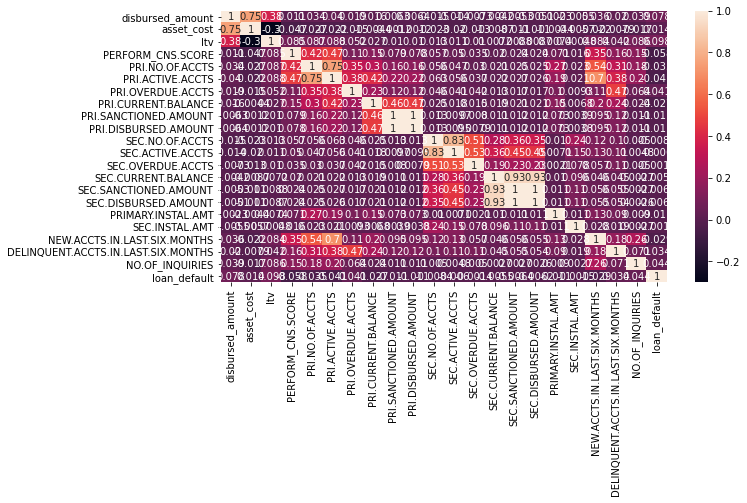

In [5]:
df_corr = df.drop(['State_ID','UniqueID','branch_id','supplier_id', 'manufacturer_id','Current_pincode_ID','Employee_code_ID'],1)

<AxesSubplot:>

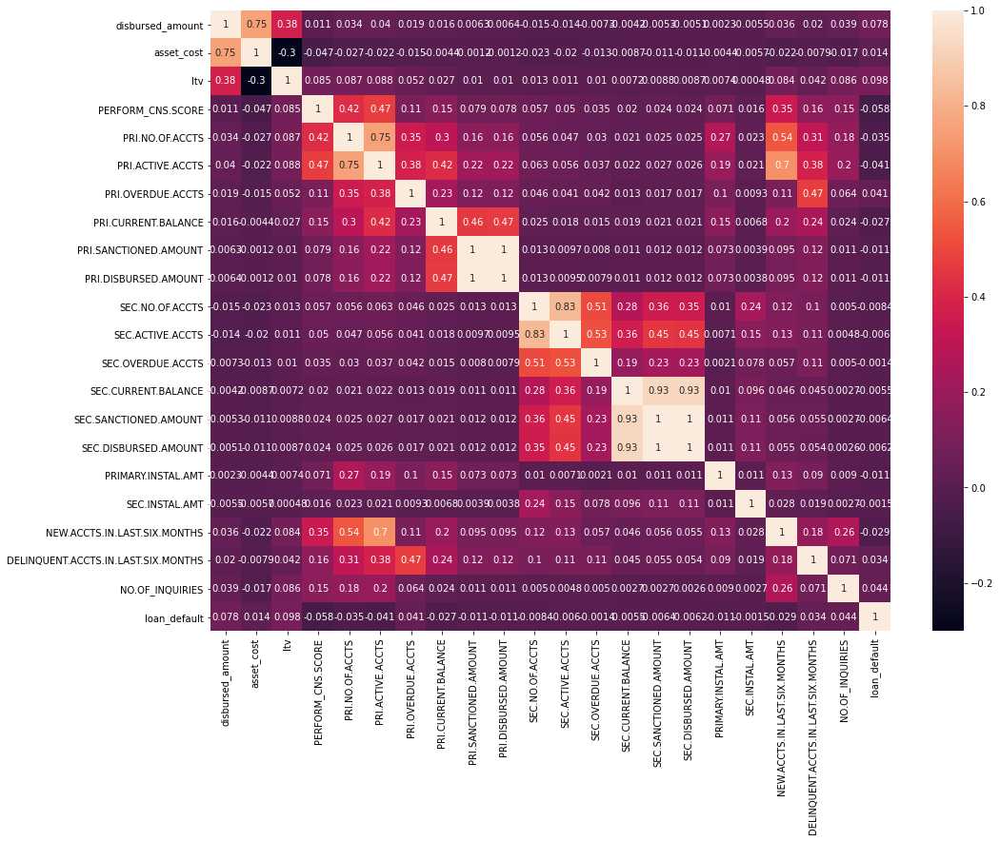

In [6]:
plt.figure(figsize=(16,12))
sns.heatmap(df_corr.corr(), annot=True)

In [38]:
df.shape

(233154, 41)

In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 233154 entries, 0 to 233153
Data columns (total 41 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   UniqueID                             233154 non-null  int64  
 1   disbursed_amount                     233154 non-null  int64  
 2   asset_cost                           233154 non-null  int64  
 3   ltv                                  233154 non-null  float64
 4   branch_id                            233154 non-null  int64  
 5   supplier_id                          233154 non-null  int64  
 6   manufacturer_id                      233154 non-null  int64  
 7   Current_pincode_ID                   233154 non-null  int64  
 8   Date.of.Birth                        233154 non-null  object 
 9   Employment.Type                      225493 non-null  object 
 10  DisbursalDate                        233154 non-null  object 
 11  State_ID     

In [40]:
df.describe()

,UniqueID,disbursed_amount,asset_cost,ltv,branch_id,supplier_id,manufacturer_id,Current_pincode_ID,State_ID,Employee_code_ID,PERFORM_CNS.SCORE,PRI.NO.OF.ACCTS,PRI.ACTIVE.ACCTS,PRI.OVERDUE.ACCTS,PRI.CURRENT.BALANCE,PRI.SANCTIONED.AMOUNT,PRI.DISBURSED.AMOUNT,SEC.NO.OF.ACCTS,SEC.ACTIVE.ACCTS,SEC.OVERDUE.ACCTS,SEC.CURRENT.BALANCE,SEC.SANCTIONED.AMOUNT,SEC.DISBURSED.AMOUNT,PRIMARY.INSTAL.AMT,SEC.INSTAL.AMT,NEW.ACCTS.IN.LAST.SIX.MONTHS,DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS,NO.OF_INQUIRIES,loan_default
count,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000,233154.00000
mean,535917.57338,54356.99353,75865.06814,74.74653,72.93609,19638.63504,69.02805,3396.88025,7.26224,1549.47715,289.46299,2.44064,1.03990,0.15655,165900.07694,218503.85532,218065.89865,0.05908,0.02770,0.00724,5427.79282,7295.92335,7179.99787,13105.48172,323.26845,0.38183,0.09748,0.20661,0.21707
std,68315.69371,12971.31417,18944.78129,11.45664,69.83499,3491.94957,22.14130,2238.14750,4.48223,975.26128,338.37478,5.21723,1.94150,0.54879,942273.58235,2374794.12577,2377743.84615,0.62679,0.31606,0.11108,170236.99464,183155.99307,182592.50007,151367.90472,15553.69134,0.95511,0.38444,0.70650,0.41225
min,417428.00000,13320.00000,37000.00000,10.03000,1.00000,10524.00000,45.00000,1.00000,1.00000,1.00000,0.00000,0.00000,0.00000,0.00000,-6678296.00000,0.00000,0.00000,0.00000,0.00000,0.00000,-574647.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
25%,476786.25000,47145.00000,65717.00000,68.88000,14.00000,16535.00000,48.00000,1511.00000,4.00000,713.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
50%,535978.50000,53803.00000,70946.00000,76.80000,61.00000,20333.00000,86.00000,2970.00000,6.00000,1451.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
75%,595039.75000,60413.00000,79201.75000,83.67000,130.00000,23000.00000,86.00000,5677.00000,10.00000,2362.00000,678.00000,3.00000,1.00000,0.00000,35006.50000,62500.00000,60800.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,1999.00000,0.00000,0.00000,0.00000,0.00000,0.00000
max,671084.00000,990572.00000,1628992.00000,95.00000,261.00000,24803.00000,156.00000,7345.00000,22.00000,3795.00000,890.00000,453.00000,144.00000,25.00000,96524920.00000,1000000000.00000,1000000000.00000,52.00000,36.00000,8.00000,36032852.00000,30000000.00000,30000000.00000,25642806.00000,4170901.00000,35.00000,20.00000,36.00000,1.00000


## Categorical Variables

#### Employment.Type

#### Relationship between Employement Type and loan default

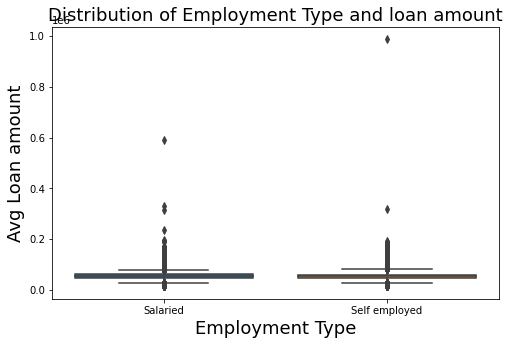

In [41]:
plt.figure(figsize=(8,5))
sns.boxplot(df['Employment.Type'],df['disbursed_amount'])
plt.title('Distribution of Employment Type and loan amount', size = 18)
plt.xlabel('Employment Type', size = 18)
plt.ylabel('Avg Loan amount', size = 18)
plt.show()

There is no difference in the loan amount given to the customer wrt employment type

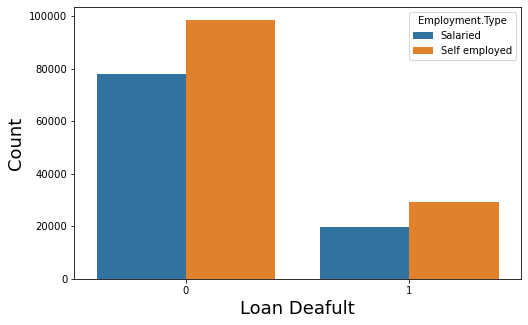

In [42]:
plt.figure(figsize=(8,5))
sns.countplot(df['loan_default'], hue = df['Employment.Type'])
plt.xlabel('Loan Deafult', size = 18)
plt.ylabel('Count', size = 18)
plt.show()

The ratio of customers being loan defaulters is equal to the ratio of customers not being defaulters for the customers who are salaried.

In [43]:
# check for null values

(df['Employment.Type'].isnull().sum() / len(df)) * 100

3.2858110948128703

In [44]:
## Check the count of each cateogry

df['Employment.Type'].value_counts(normalize = True)

Self employed   0.56603
Salaried        0.43397
Name: Employment.Type, dtype: float64

In [45]:
## Impute the null values with mode
df['Employment.Type'] = df['Employment.Type'].fillna(df['Employment.Type'].mode()[0])

In [46]:
df['Employment.Type'].value_counts(normalize = True)

Self employed   0.58029
Salaried        0.41971
Name: Employment.Type, dtype: float64

#### Current_pincode_ID

In [47]:
df['Current_pincode_ID'].value_counts()

2578    1880
1446    1731
1515    1087
2989     934
2943     899
1509     864
2782     841
1794     809
571      781
3363     730
2378     720
1511     683
89       634
293      607
3000     578
3340     570
2790     567
738      539
475      506
1429     503
2959     503
2946     497
1730     495
1713     489
299      481
43       468
104      462
1514     454
1508     450
51       450
1721     443
60       437
789      429
298      417
57       410
1449     410
1676     403
6814     402
3342     400
3386     400
1854     395
2940     395
2377     393
1754     385
1732     383
1631     377
551      376
7125     365
2944     361
769      358
936      357
771      351
1838     347
992      346
6926     345
2796     341
1880     340
17       339
2951     333
3013     332
3373     332
2610     331
1510     329
1323     326
1047     325
1810     322
1655     321
1720     320
2694     317
1050     312
87       312
1043     311
6734     305
2783     304
3339     301
854      299
3323     297

There are 6698 unique Current_Pincode_ID with the highest loan takers from pincode 2578 with count of 1880. As there are too many unique values, this feature will be dropped later

#### Unique ID

In [48]:
df['UniqueID'].value_counts()

526335    1
426629    1
520875    1
522922    1
516777    1
518824    1
496295    1
498342    1
492197    1
494244    1
504483    1
506530    1
500385    1
502432    1
422555    1
424602    1
418457    1
420504    1
447119    1
449166    1
443021    1
445068    1
455307    1
457354    1
451209    1
453256    1
430727    1
510636    1
508589    1
514734    1
477884    1
561991    1
564038    1
557893    1
559940    1
570179    1
572226    1
566081    1
568128    1
479935    1
481982    1
475837    1
488123    1
512687    1
490170    1
484025    1
486072    1
463543    1
465590    1
459445    1
461492    1
471731    1
473778    1
467633    1
469680    1
432774    1
428676    1
582473    1
438915    1
623205    1
625252    1
635491    1
637538    1
631393    1
633440    1
545375    1
547422    1
541277    1
543324    1
553563    1
555610    1
549465    1
551512    1
528983    1
531030    1
524885    1
526932    1
537171    1
539218    1
533073    1
535120    1
578127    1
580174    1
5740

As there are too many unique values, this feature will be dropped later

#### Branch ID

In [49]:
df['branch_id'].value_counts()

2      13138
67     11328
3       9230
5       9218
36      8832
136     7833
34      7794
16      6466
19      5860
1       5709
146     5376
18      5032
152     4933
61      4906
48      4725
11      4506
20      4431
138     4352
74      4297
120     4210
147     4160
10      4125
103     3878
251     3844
65      3509
160     3505
79      3413
7       3222
135     3203
8       3146
15      2975
13      2972
162     2758
159     2725
42      2714
9       2528
105     2464
68      2314
78      2182
202     1999
63      1954
85      1876
248     1837
70      1757
254     1699
104     1651
255     1650
64      1646
14      1558
29      1545
250     1481
73      1454
77      1445
72      1294
257     1256
17      1160
130     1069
82      1035
165     1021
121      884
249      858
76       855
69       810
35       693
153      692
62       691
207      689
43       584
117      558
142      473
97       389
258      374
260      372
101      368
259      346
100      331
66       314

As there are too many unique values, this feature will be dropped later

#### State ID

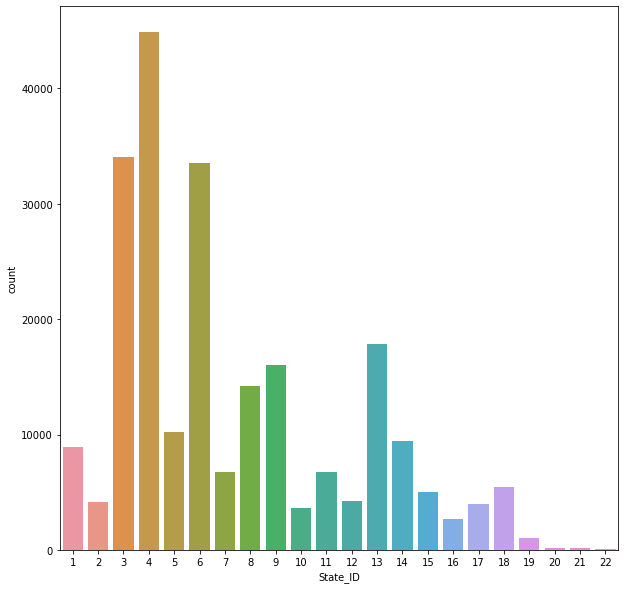

In [50]:
plt.figure(figsize=(10,10))
sns.countplot(df['State_ID'])
plt.show()

<AxesSubplot:xlabel='State_ID_cat', ylabel='count'>

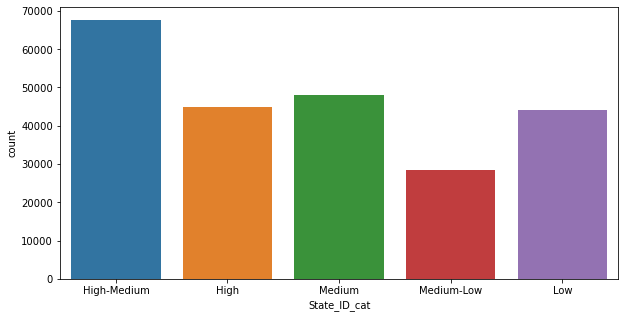

In [88]:
sns.countplot(df['State_ID_cat'])

In [51]:
df['State_ID'].value_counts()/len(df)*100

4    19.24479
3    14.61609
6    14.37033
13    7.67047
9     6.87185
8     6.08911
5     4.36493
14    4.03767
1     3.83266
7     2.91052
11    2.88264
18    2.32121
15    2.16552
12    1.80567
2     1.78423
17    1.71174
10    1.54619
16    1.15160
19    0.44391
20    0.07935
21    0.06691
22    0.03260
Name: State_ID, dtype: float64

In [52]:
encoding = df.groupby('State_ID').size()
encoding = (encoding/len(df))*100
df['State_ID'] = df['State_ID'].map(encoding)
df['State_ID'].value_counts()

19.24479    44870
14.61609    34078
14.37033    33505
7.67047     17884
6.87185     16022
6.08911     14197
4.36493     10177
4.03767      9414
3.83266      8936
2.91052      6786
2.88264      6721
2.32121      5412
2.16552      5049
1.80567      4210
1.78423      4160
1.71174      3991
1.54619      3605
1.15160      2685
0.44391      1035
0.07935       185
0.06691       156
0.03260        76
Name: State_ID, dtype: int64

In [53]:
def new_feature(state_id_per):
    if (state_id_per >= 16.00):
        return 'High'
    if (state_id_per >= 14.00 and state_id_per < 16.00):
        return 'High-Medium'
    if (state_id_per >= 6.00 and state_id_per < 8.00):
        return 'Medium'
    if (state_id_per >= 3.00 and state_id_per < 5.00):
        return 'Medium-Low'
    if (state_id_per >= 0 and state_id_per < 3.00):
        return 'Low'

In [54]:
df['State_ID_cat'] = df['State_ID'].apply(new_feature)

In [55]:
df['State_ID_cat'].value_counts()

High-Medium    67583
Medium         48103
High           44870
Low            44071
Medium-Low     28527
Name: State_ID_cat, dtype: int64

In [56]:
df = df.drop('State_ID',1)

#### Disbursal Date

In [57]:
df['Disbursal_year'] = df['DisbursalDate'].apply(lambda x:x.split(',')[2])
df['Disbursal_year'].value_counts()

 2018    233154
Name: Disbursal_year, dtype: int64

All the loans were disbursed in the year 2018

In [58]:
import datetime
date1 = []

for i in df['DisbursalDate']:
    date = datetime.datetime.strptime(i, '%A, %B %d, %Y').strftime('%d/%m/%Y')
    date1.append(date)

In [59]:
df['Disbursed_Date'] = date1

In [60]:
df = df.drop(['Disbursal_year','DisbursalDate'],1)

In [61]:
from datetime import datetime
date_format = "%d/%m/%Y"
loan_age = []

for i in df['Disbursed_Date']:
    loan = datetime.strptime('31/12/2018', date_format)-datetime.strptime(i, date_format)
    loan_age.append(loan)
    
df['loan_age'] = loan_age

In [62]:
df['loan_age'] = df['loan_age'].apply(lambda x:str(x).split(' ')[0])
df['loan_age'] = df['loan_age'].astype(int)

In [63]:
df = df.drop('Disbursed_Date',1)

#### Date of Birth

In [64]:
df['Date.of.Birth']

0               Sunday, January 1, 1984
1              Wednesday, July 31, 1985
2             Saturday, August 24, 1985
3           Thursday, December 30, 1993
4              Friday, December 9, 1977
5           Saturday, September 8, 1990
6               Wednesday, June 1, 1988
7            Wednesday, October 4, 1989
8             Friday, November 15, 1991
9                Saturday, June 1, 1968
10              Monday, January 1, 1979
11            Friday, September 7, 1984
12               Saturday, June 1, 1974
13            Thursday, August 16, 1984
14            Sunday, February 18, 1973
15                Tuesday, July 5, 1994
16                Tuesday, June 1, 1976
17            Sunday, February 27, 1983
18           Wednesday, August 10, 1988
19            Wednesday, April 16, 1980
20          Wednesday, November 1, 1978
21         Wednesday, February 29, 1984
22              Thursday, July 14, 1994
23               Thursday, May 31, 1979
24              Monday, January 2, 1989


In [65]:
#Age
df['Date.of.Birth'].apply(lambda x:x.split(',')[2])
df['Date.of.Birth'] = pd.to_datetime(df['Date.of.Birth'])
def date_feature(x):
    if x.year >= 1949 and x.year < 1959:
        return '60-70'
    elif x.year >= 1959 and x.year < 1969:
        return '50-60'
    elif x.year >= 1969 and x.year < 1979:
        return '40-50'
    elif x.year >= 1979 and x.year < 1989:
        return '30-40'
    elif x.year >= 1989 and x.year <= 2000:
        return '20-30'
df['Age']=df['Date.of.Birth'].apply(date_feature)

In [68]:
df['Age'].value_counts()

20-30    92039
30-40    74447
40-50    46802
50-60    18305
60-70     1561
Name: Age, dtype: int64

In [77]:
pd.crosstab(df['Age'],df['loan_default']).apply(lambda r: r/r.sum()*100,axis=1)

loan_default,0,1
Age,,
20-30,76.65989,23.34011
30-40,78.73521,21.26479
40-50,79.74018,20.25982
50-60,80.54084,19.45916
60-70,83.72838,16.27162


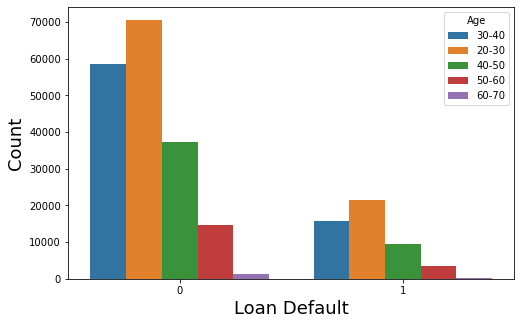

In [102]:
#Relationship between Age and target column
plt.figure(figsize=(8,5))
sns.countplot(df['loan_default'], hue = df['Age'])
plt.xlabel('Loan Default', size = 18)
plt.ylabel('Count', size = 18)
plt.show()

In [ ]:
pd.crosstab()

#### Asset Cost

In [ ]:
plt.figure(figsize=(8,5))
sns.distplot(df['asset_cost'],hist=False)
plt.show()

#### Supplier ID

In [ ]:
plt.figure(figsize=(8,5))
sns.distplot(df['supplier_id'],hist=False)
plt.show()

#### Manufacturer ID

In [ ]:
plt.figure(figsize=(8,5))
sns.distplot(df['manufacturer_id'],hist=False)
plt.show()

### Flag Columns:

#### Passport Flag

In [ ]:
plt.figure(figsize=(10,7))
sns.countplot(df['Passport_flag'])
plt.title('Distribution of Passport flag', size = 24)
plt.xlabel('Passport Flag', size = 20)
plt.ylabel('Count', size = 20)
plt.show()

In [ ]:
plt.figure(figsize=(30,20))
sns.catplot(x='Passport_flag',hue='loan_default',kind='count',data=df)
plt.title('Distribution of Passport flag with loan default', size = 15)
plt.show()

In [ ]:
pd.crosstab(index=df['loan_default'],values=df['Passport_flag'],columns=df['Passport_flag'],aggfunc='count')

The number of loan defaulters who have submitted their Passport are very low

#### Driving Flag

In [ ]:
plt.figure(figsize=(10,7))
sns.countplot(df['Driving_flag'])
plt.title('Distribution of Driving flag', size = 24)
plt.xlabel('Driving Flag', size = 20)
plt.ylabel('Count', size = 20)
plt.show()

#### Mobile Flag

In [ ]:
plt.figure(figsize=(8,5))
sns.countplot(df['MobileNo_Avl_Flag'])
plt.title('Distribution of Mobile No. flag', size = 18)
plt.xlabel('Mobile No Flag', size = 18)
plt.ylabel('Count', size = 18)
plt.show()

All the customers have given their mobile number. And as a result it will not make any effect on the target column

#### Aadhar Flag

In [ ]:
plt.figure(figsize=(8,5))
sns.countplot(df['Aadhar_flag'])
plt.title('Distribution of Aadhar flag', size = 18)
plt.xlabel('Aadhar Flag', size = 18)
plt.ylabel('Count', size = 18)
plt.show()

Only quarter of the people have not submitted their aadhar card number.

**Relationship between Employement Type and Aadhar Flag**

In [ ]:
plt.figure(figsize=(8,5))
sns.countplot(df['Aadhar_flag'], hue = df['Employment.Type'])
plt.title('Distribution of Aadhar flag with EmploymentType', size = 18)
plt.xlabel('Aadhar Flag', size = 18)
plt.ylabel('Count', size = 18)
plt.show()

Self employeed customers are more in both submitted group and not submitted group. Only quarter of the people have not submitted their aadhar card number

**Relation between Aadhar Flag and target column**

In [ ]:
pd.crosstab(df['loan_default'], df['Aadhar_flag'])

In [ ]:
plt.figure(figsize=(8,5))
sns.countplot(df['loan_default'], hue = df['Aadhar_flag'])
plt.xlabel('Loan Deafult', size = 18)
plt.ylabel('Count', size = 18)
plt.show()

The ratio of customers being loan defaulters is equal to the ratio of customers not being defaulters for those customers who have given the aadhar number. So this feature will not be considered individually in the model

#### VoterID Flag

In [ ]:
plt.figure(figsize=(8,5))
sns.countplot(df['VoterID_flag'])
plt.show()

**Relationship between target column and VoterID_flag**

In [ ]:
plt.figure(figsize=(8,5))
sns.countplot(df['loan_default'], hue = df['VoterID_flag'])
plt.xlabel('Loan Deafult', size = 18)
plt.ylabel('Count', size = 18)
plt.show()

#### Pan Flag

In [ ]:
plt.figure(figsize=(8,5))
sns.countplot(df['PAN_flag'])
plt.show()

**Relationship between target column and PAN_flag**

In [ ]:
plt.figure(figsize=(8,5))
sns.countplot(df['loan_default'], hue = df['PAN_flag'])
plt.xlabel('Loan Deafult', size = 18)
plt.ylabel('Count', size = 18)
plt.show()

#### Label Encoding the flag columns

In [35]:
mydict = {'Yes':1,'No':0}

df['Driving_flag'] = df['Driving_flag'].map(mydict)

df['Passport_flag'] = df['Passport_flag'].map(mydict)

df['VoterID_flag']=df['VoterID_flag'].map(mydict)

df['PAN_flag']=df['PAN_flag'].map(mydict)

df['Aadhar_flag']=df['Aadhar_flag'].map(mydict)

df['MobileNo_Avl_Flag']=df['MobileNo_Avl_Flag'].map(mydict)

0.00001    182745
0.00003     25251
0.00007      9933
0.00009      6095
0.00019      4051
0.00004      2005
0.00006       973
0.00019       845
0.00202       369
0.00025       273
0.00010       241
0.00022       170
0.00203        76
0.00025        51
0.00208        29
0.00022        12
0.00208        11
0.00028        10
0.00205         5
0.00220         3
0.00028         3
0.00211         1
0.00211         1
0.00221         1
Name: total_verification_wts, dtype: int64


<AxesSubplot:xlabel='loan_default', ylabel='total_verification_wts'>

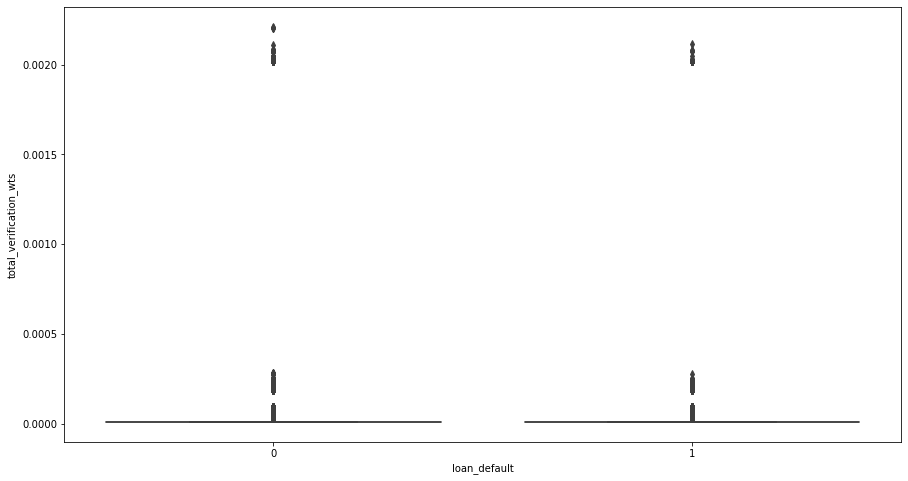

In [36]:
#Total verification weights
df['PAN_wts']=df['PAN_flag']/sum(df['PAN_flag'])
df['PAN_wts'].value_counts()
df['Aadhar_wts']=df['Aadhar_flag']/sum(df['Aadhar_flag'])
df['Aadhar_wts'].value_counts()
df['Passport_wts']=df['Passport_flag']/sum(df['Passport_flag'])
df['Passport_wts'].value_counts()
df['Driving_wts']=df['Driving_flag']/sum(df['Driving_flag'])
df['Driving_wts'].value_counts()
df['VoterID_wts']=df['VoterID_flag']/sum(df['VoterID_flag'])
df['VoterID_wts'].value_counts()
df['MobileNo_Avl_wts']=df['MobileNo_Avl_Flag']/sum(df['MobileNo_Avl_Flag'])
df['MobileNo_Avl_wts'].value_counts()
df['total_verification_wts']=df['MobileNo_Avl_wts']+df['VoterID_wts']+df['Driving_wts']+df['Passport_wts']+df['Aadhar_wts']+df['PAN_wts']
print(df['total_verification_wts'].value_counts())
plt.figure(figsize=(15,8))
sns.boxplot(x=df['loan_default'],y=df['total_verification_wts'])

In [37]:
df = df.drop(['Driving_flag','Passport_flag','VoterID_flag','PAN_flag','Aadhar_flag','MobileNo_Avl_Flag'],1)

In [38]:
df = df.drop(['Driving_wts','PAN_wts','Aadhar_wts','Passport_wts','VoterID_wts','MobileNo_Avl_wts'],1)

## Numerical Columns

#### LTV

In [ ]:
df['ltv'].describe()

In [ ]:
sns.distplot(df['ltv'],hist=False)
plt.show()

In [ ]:
df['ltv'].skew()

In [39]:
from scipy.stats import boxcox
a, b = boxcox(df['ltv'])
df['ltv'] = a

In [ ]:
sns.distplot(df['ltv'],hist=False)
plt.show()

In [ ]:
df['ltv'].skew()

In [ ]:
df['ltv'].describe()

#### Disbursed amount

In [40]:
df['disbursed_amount'].isnull().sum()

0

**Check for Variance**

In [ ]:
df['disbursed_amount'].describe()

By looking at the quantiles and the mean, we can say that there is a lot of variance in the feature.

**Outliers**

In [ ]:
df['disbursed_amount'].skew()

In [ ]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
dist_plot = sns.boxplot(df['disbursed_amount'])
plt.title('Distribution of Disbursed amount', size = 18)
plt.subplot(1,2,2)
dist_plot = sns.distplot(df['disbursed_amount'], rug= True)
plt.title('Distribution of Disbursed amount', size = 18)

plt.show()

**Capping to get rid of Outliers**

In [41]:
df['disbursed_amount'] = df['disbursed_amount'].clip(lower =df['disbursed_amount'].quantile(0.025), upper =  df['disbursed_amount'].quantile(0.975))

In [ ]:
plt.figure(figsize=(15,5))
plt.subplot(1,2,1)
dist_plot = sns.boxplot(df['disbursed_amount'])
plt.title('Distribution of Disbursed amount', size = 18)
plt.subplot(1,2,2)
dist_plot = sns.distplot(df['disbursed_amount'], rug= True)
plt.title('Distribution of Disbursed amount', size = 18)

plt.show()

In [ ]:
## Check the skewness after capping
df['disbursed_amount'].skew()

#### Asset Cost

In [ ]:
plt.figure(figsize=(15,8))
sns.distplot(df['asset_cost'],hist=False)

In [ ]:
df['asset_cost'].skew()

In [ ]:
plt.figure(figsize=(15,8))
sns.boxplot(df['asset_cost'])

<AxesSubplot:xlabel='asset_cost', ylabel='Density'>

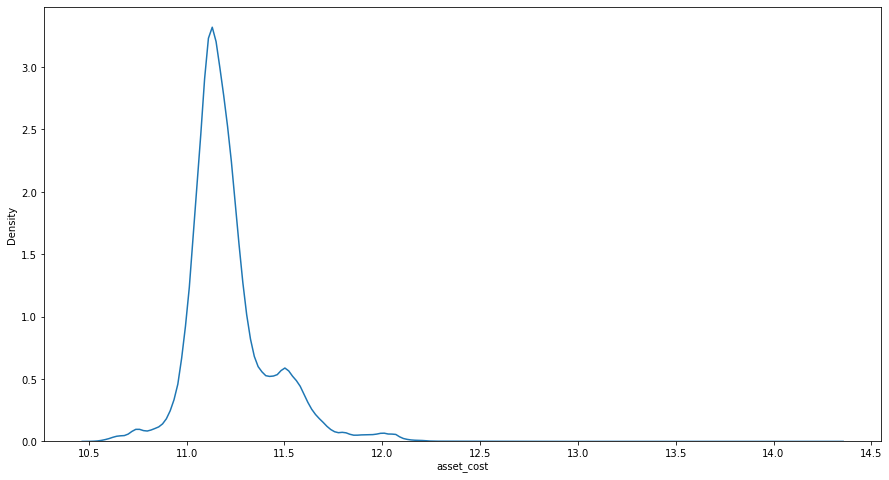

In [42]:
#Log Transformation
plt.figure(figsize=(15,8))
sns.distplot(np.log(df['asset_cost']),hist=False)

<AxesSubplot:xlabel='ltv', ylabel='asset_cost'>

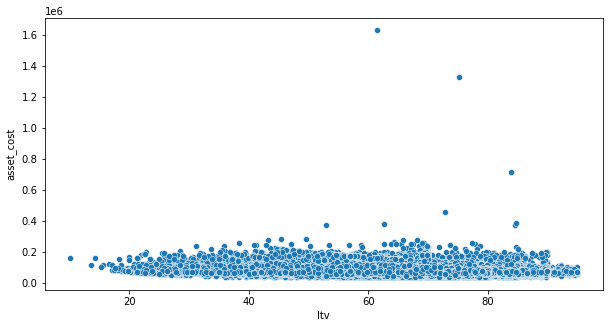

In [83]:

sns.scatterplot(df['ltv'],df['asset_cost'])

<AxesSubplot:xlabel='disbursed_amount', ylabel='PERFORM_CNS.SCORE'>

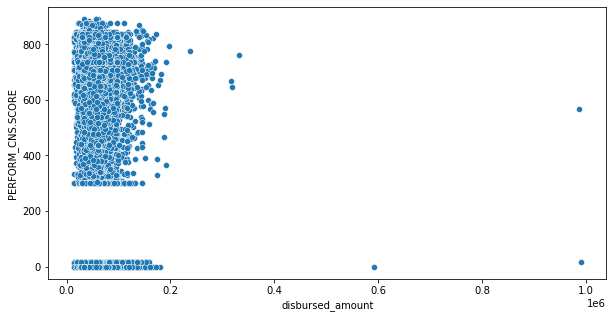

In [85]:
sns.scatterplot(df['disbursed_amount'],df['PERFORM_CNS.SCORE'])

<AxesSubplot:xlabel='PERFORM_CNS.SCORE', ylabel='Density'>

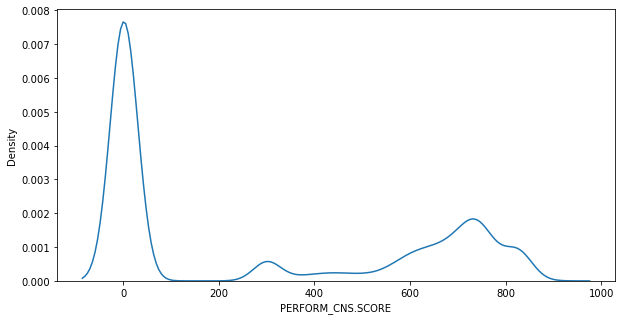

In [87]:
sns.distplot(df['PERFORM_CNS.SCORE'],hist=False)

In [ ]:
np.log(df['asset_cost']).describe()

In [ ]:
np.log(df['asset_cost']).skew()

#### PERFORM_CNS.SCORE.DESCRIPTION

In [ ]:
df['PERFORM_CNS.SCORE.DESCRIPTION'].value_counts()

In [43]:
df['PERFORM_CNS.SCORE.DESCRIPTION'].value_counts(normalize=True)*100

No Bureau History Available                               50.15998
C-Very Low Risk                                            6.88172
A-Very Low Risk                                            6.05780
D-Very Low Risk                                            4.87146
B-Very Low Risk                                            3.94632
M-Very High Risk                                           3.76404
F-Low Risk                                                 3.63923
K-High Risk                                                3.55001
H-Medium Risk                                              2.94012
E-Low Risk                                                 2.49663
I-Medium Risk                                              2.38340
G-Low Risk                                                 1.71046
Not Scored: Sufficient History Not Available               1.61481
J-High Risk                                                1.60752
Not Scored: Not Enough Info available on the customer      1.5

In [44]:
def split_data(var):
    score=var.split('-')
    if len(score)!=1:
        return score[0]
    else:
        return 'N'
    
def transform_cns_score_dec(data):
    data['PERFORM_CNS.SCORE.DESCRIPTION']=data['PERFORM_CNS.SCORE.DESCRIPTION'].apply(split_data)

In [45]:
transform_cns_score_dec(df)

In [46]:
df['PERFORM_CNS.SCORE.DESCRIPTION']=df['PERFORM_CNS.SCORE.DESCRIPTION'].replace({'N':'Not Scored', 'A':'Very Low Risk',
                                                                                   'B':'Very Low Risk','C':'Very Low Risk',
                                                                                   'D':'Very Low Risk',
                                                                                   'E':'Low Risk',
                                                                                   'F':'Low Risk',
                                                                                   'G':'Low Risk',
                                                                                   'H':'Medium Risk', 'I':'Medium Risk',
                                                                                   'J':'High Risk', 'K':'High Risk',
                                                                                   'L':'Very High Risk', 'M':'Very High Risk'})

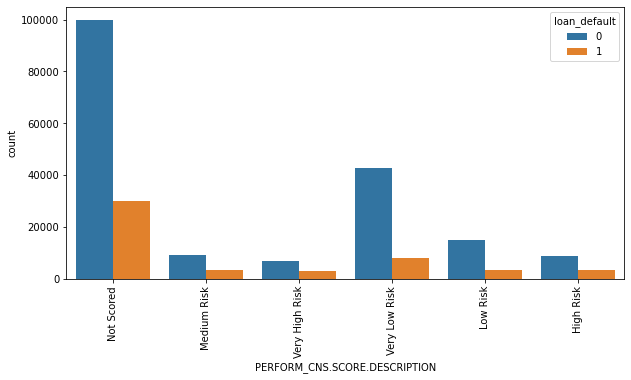

In [47]:
sns.countplot(df['PERFORM_CNS.SCORE.DESCRIPTION'],hue=df['loan_default'])
plt.xticks(rotation=90)
plt.show()

#### PERFORM_CNS.SCORE

<AxesSubplot:xlabel='PERFORM_CNS.SCORE'>

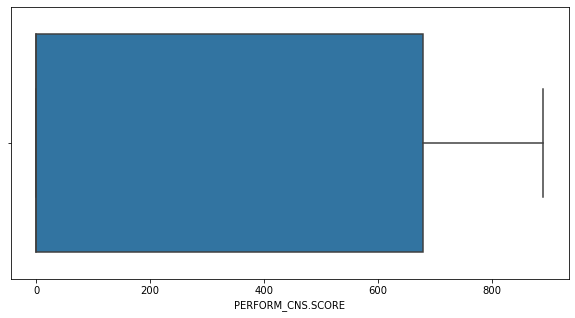

In [48]:
sns.boxplot(df['PERFORM_CNS.SCORE'])

<AxesSubplot:xlabel='loan_default', ylabel='PERFORM_CNS.SCORE'>

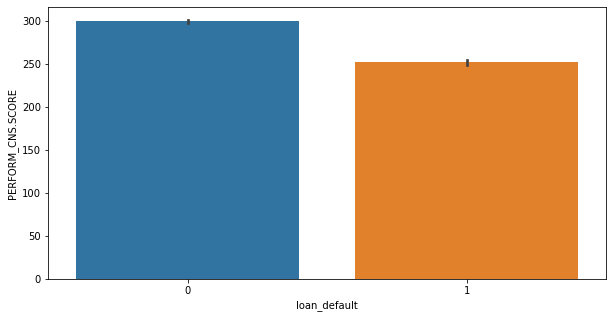

In [49]:
sns.barplot(y= df['PERFORM_CNS.SCORE'], x=df['loan_default'])

Customers with less PERFORM_CNS.SCORE are more prone to loan default

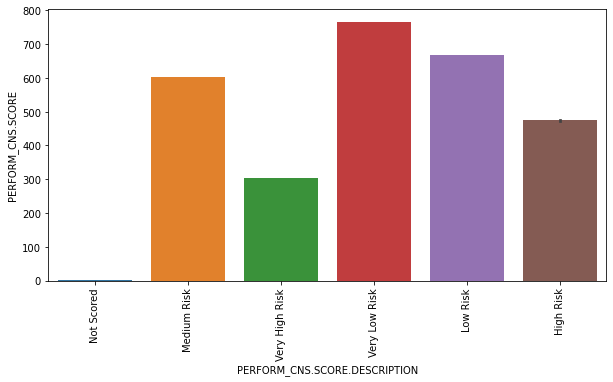

In [50]:
sns.barplot(df['PERFORM_CNS.SCORE.DESCRIPTION'],df['PERFORM_CNS.SCORE'])
plt.xticks(rotation=90)
plt.show()

We can infer from above plot that higher the risk lower is the PERFORM_CNS.SCORE

#### AVERAGE_ACCT_AGE & CREDIT_HISTORY_LENGTH

In [51]:
#Now we have 2 Columns named "AVERAGE_ACCT_AGE" & "CREDIT_HISTORY_LENGTH".
#They have AplhNumeric Values Lets change them to Months

def change_col_month(col):
    year = int(col.split()[0].replace('yrs',''))
    month = int(col.split()[1].replace('mon',''))
    return year*12+month

def months_transformation(data):
    data['CREDIT.HISTORY.LENGTH'] = data['CREDIT.HISTORY.LENGTH'].apply(change_col_month)
    data['AVERAGE.ACCT.AGE'] = data['AVERAGE.ACCT.AGE'].apply(change_col_month)

In [52]:
months_transformation(df)

<AxesSubplot:xlabel='AVERAGE.ACCT.AGE'>

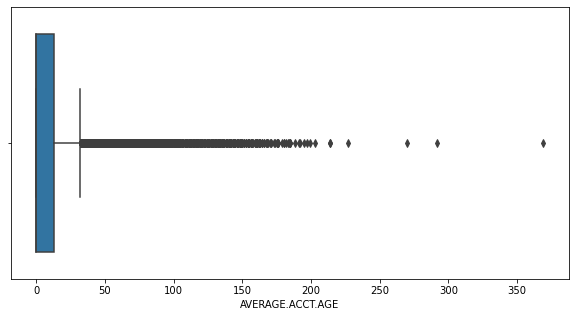

In [53]:
sns.boxplot(df['AVERAGE.ACCT.AGE'])

In [ ]:
sns.boxplot(df['CREDIT.HISTORY.LENGTH'])

**Remaining Numeric Columns**

**Before Transformation Skewness check**

In [54]:
df.loc[:,['PERFORM_CNS.SCORE', 'PERFORM_CNS.SCORE.DESCRIPTION', 'PRI.NO.OF.ACCTS','PRI.ACTIVE.ACCTS', 
        'PRI.OVERDUE.ACCTS', 'PRI.CURRENT.BALANCE','PRI.SANCTIONED.AMOUNT', 'PRI.DISBURSED.AMOUNT', 'SEC.NO.OF.ACCTS',
        'SEC.ACTIVE.ACCTS', 'SEC.OVERDUE.ACCTS', 'SEC.CURRENT.BALANCE',
       'SEC.SANCTIONED.AMOUNT', 'SEC.DISBURSED.AMOUNT', 'PRIMARY.INSTAL.AMT',
       'SEC.INSTAL.AMT', 'NEW.ACCTS.IN.LAST.SIX.MONTHS',
       'DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS', 'AVERAGE.ACCT.AGE',
       'CREDIT.HISTORY.LENGTH', 'NO.OF_INQUIRIES', 'loan_default']].skew()

PERFORM_CNS.SCORE                       0.44515
PRI.NO.OF.ACCTS                         9.74485
PRI.ACTIVE.ACCTS                        5.37185
PRI.OVERDUE.ACCTS                       7.51293
PRI.CURRENT.BALANCE                    29.42581
PRI.SANCTIONED.AMOUNT                 323.69721
PRI.DISBURSED.AMOUNT                  322.54149
SEC.NO.OF.ACCTS                        27.98609
SEC.ACTIVE.ACCTS                       30.59951
SEC.OVERDUE.ACCTS                      24.12927
SEC.CURRENT.BALANCE                   108.50630
SEC.SANCTIONED.AMOUNT                  75.25493
SEC.DISBURSED.AMOUNT                   75.76425
PRIMARY.INSTAL.AMT                     69.91616
SEC.INSTAL.AMT                        153.80637
NEW.ACCTS.IN.LAST.SIX.MONTHS            4.83933
DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS     6.64200
AVERAGE.ACCT.AGE                        3.28514
CREDIT.HISTORY.LENGTH                   2.96916
NO.OF_INQUIRIES                         7.87068
loan_default                            

**Boxplots before sqrt tranformation**

In [ ]:
sns.boxplot(df['PRI.NO.OF.ACCTS'])
print('Skewness:',df['PRI.NO.OF.ACCTS'].skew())

In [ ]:
sns.boxplot(df['PRI.ACTIVE.ACCTS'])
print('Skewness:',df['PRI.ACTIVE.ACCTS'].skew())

In [ ]:
sns.boxplot(df['PRI.OVERDUE.ACCTS'])
print('Skewness:',df['PRI.OVERDUE.ACCTS'].skew())

In [ ]:
sns.boxplot(df['PRI.CURRENT.BALANCE'])
print('Skewness:',df['PRI.CURRENT.BALANCE'].skew())

In [ ]:
sns.boxplot(df['PRI.SANCTIONED.AMOUNT'])
print('Skewness:',df['PRI.SANCTIONED.AMOUNT'].skew())

In [ ]:
sns.boxplot(df['PRI.DISBURSED.AMOUNT'])
print('Skewness:',df['PRI.DISBURSED.AMOUNT'].skew())

In [ ]:
sns.boxplot(df['SEC.NO.OF.ACCTS'])
print('Skewness:',df['SEC.NO.OF.ACCTS'].skew())

In [ ]:
sns.boxplot(df['SEC.ACTIVE.ACCTS'])
print('Skewness:',df['SEC.ACTIVE.ACCTS'].skew())

In [ ]:
sns.boxplot(df['SEC.OVERDUE.ACCTS'])
print('Skewness:',df['SEC.OVERDUE.ACCTS'].skew())

In [ ]:
sns.boxplot(df['SEC.CURRENT.BALANCE'])
print('Skewness:',df['SEC.CURRENT.BALANCE'].skew())

In [ ]:
sns.boxplot(df['SEC.SANCTIONED.AMOUNT'])
print('Skewness:',df['SEC.SANCTIONED.AMOUNT'].skew())

In [ ]:
sns.boxplot(df['SEC.DISBURSED.AMOUNT'])
print('Skewness:',df['SEC.DISBURSED.AMOUNT'].skew())

In [ ]:
sns.boxplot(df['PRIMARY.INSTAL.AMT'])
print('Skewness:',df['PRIMARY.INSTAL.AMT'].skew())

In [ ]:
sns.boxplot(df['SEC.INSTAL.AMT'])
print('Skewness:',df['SEC.INSTAL.AMT'].skew())

In [ ]:
sns.boxplot(df['NEW.ACCTS.IN.LAST.SIX.MONTHS'])
print('Skewness:',df['NEW.ACCTS.IN.LAST.SIX.MONTHS'].skew())

In [ ]:
sns.boxplot(df['DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS'])
print('Skewness:',df['DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS'].skew())

In [ ]:
sns.boxplot(df['AVERAGE.ACCT.AGE'])
print('Skewness:',df['AVERAGE.ACCT.AGE'].skew())

In [ ]:
sns.boxplot(df['CREDIT.HISTORY.LENGTH'])
print('Skewness:',df['CREDIT.HISTORY.LENGTH'].skew())

In [ ]:
sns.boxplot(df['NO.OF_INQUIRIES'])
print('Skewness:',df['NO.OF_INQUIRIES'].skew())

**Transforming the columns with square root transformation as more of zero's are present.**

In [55]:
#Transforming the columns with square root transformation as more of zero's are present.

df['PRI.NO.OF.ACCTS']=np.sqrt((df['PRI.NO.OF.ACCTS']))

df['PRI.ACTIVE.ACCTS']=np.sqrt((df['PRI.ACTIVE.ACCTS']))

df['PRI.OVERDUE.ACCTS']=np.sqrt((df['PRI.OVERDUE.ACCTS']))

df['PRI.CURRENT.BALANCE']=np.sqrt((df['PRI.CURRENT.BALANCE']))

df['PRI.SANCTIONED.AMOUNT']=np.sqrt((df['PRI.SANCTIONED.AMOUNT']))

df['PRI.DISBURSED.AMOUNT']=np.sqrt((df['PRI.DISBURSED.AMOUNT']))

df['SEC.NO.OF.ACCTS']=np.sqrt((df['SEC.NO.OF.ACCTS']))

df['SEC.ACTIVE.ACCTS']=np.sqrt((df['SEC.ACTIVE.ACCTS']))

df['SEC.OVERDUE.ACCTS']=np.sqrt((df['SEC.OVERDUE.ACCTS']))

df['SEC.CURRENT.BALANCE']=np.sqrt((df['SEC.CURRENT.BALANCE']))

df['SEC.SANCTIONED.AMOUNT']=np.sqrt((df['SEC.SANCTIONED.AMOUNT']))

df['SEC.DISBURSED.AMOUNT']=np.sqrt((df['SEC.DISBURSED.AMOUNT']))

df['PRIMARY.INSTAL.AMT']=np.sqrt((df['PRIMARY.INSTAL.AMT']))

df['SEC.INSTAL.AMT']=np.sqrt((df['SEC.INSTAL.AMT']))

df['NEW.ACCTS.IN.LAST.SIX.MONTHS']=np.sqrt((df['NEW.ACCTS.IN.LAST.SIX.MONTHS']))

df['DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS']=np.sqrt((df['DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS']))

df['AVERAGE.ACCT.AGE']=np.sqrt((df['AVERAGE.ACCT.AGE']))

df['CREDIT.HISTORY.LENGTH']=np.sqrt((df['CREDIT.HISTORY.LENGTH']))

df['NO.OF_INQUIRIES']=np.sqrt((df['NO.OF_INQUIRIES']))


**After Transformation Skewness check**

In [ ]:
df.loc[:,['PERFORM_CNS.SCORE', 'PERFORM_CNS.SCORE.DESCRIPTION', 'PRI.NO.OF.ACCTS','PRI.ACTIVE.ACCTS', 
        'PRI.OVERDUE.ACCTS', 'PRI.CURRENT.BALANCE','PRI.SANCTIONED.AMOUNT', 'PRI.DISBURSED.AMOUNT', 'SEC.NO.OF.ACCTS',
        'SEC.ACTIVE.ACCTS', 'SEC.OVERDUE.ACCTS', 'SEC.CURRENT.BALANCE',
       'SEC.SANCTIONED.AMOUNT', 'SEC.DISBURSED.AMOUNT', 'PRIMARY.INSTAL.AMT',
       'SEC.INSTAL.AMT', 'NEW.ACCTS.IN.LAST.SIX.MONTHS',
       'DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS', 'AVERAGE.ACCT.AGE',
       'CREDIT.HISTORY.LENGTH', 'NO.OF_INQUIRIES', 'loan_default']].skew()

We can observe that skewness has reduced after performing Sqrt Transformation

**Boxplots after sqrt transformation**

In [ ]:
sns.boxplot(df['PRI.NO.OF.ACCTS'])
print('Skewness:',df['PRI.NO.OF.ACCTS'].skew())

In [ ]:
sns.boxplot(df['PRI.ACTIVE.ACCTS'])
print('Skewness:',df['PRI.ACTIVE.ACCTS'].skew())

In [ ]:
sns.boxplot(df['PRI.OVERDUE.ACCTS'])
print('Skewness:',df['PRI.OVERDUE.ACCTS'].skew())

In [ ]:
sns.boxplot(df['PRI.CURRENT.BALANCE'])
print('Skewness:',df['PRI.CURRENT.BALANCE'].skew())

In [ ]:
sns.boxplot(df['PRI.SANCTIONED.AMOUNT'])
print('Skewness:',df['PRI.SANCTIONED.AMOUNT'].skew())

In [ ]:
sns.boxplot(df['PRI.DISBURSED.AMOUNT'])
print('Skewness:',df['PRI.DISBURSED.AMOUNT'].skew())

In [ ]:
sns.boxplot(df['SEC.NO.OF.ACCTS'])
print('Skewness:',df['SEC.NO.OF.ACCTS'].skew())

In [ ]:
sns.boxplot(df['SEC.ACTIVE.ACCTS'])
print('Skewness:',df['SEC.ACTIVE.ACCTS'].skew())

In [ ]:
sns.boxplot(df['SEC.OVERDUE.ACCTS'])
print('Skewness:',df['SEC.OVERDUE.ACCTS'].skew())

In [ ]:
sns.boxplot(df['SEC.CURRENT.BALANCE'])
print('Skewness:',df['SEC.CURRENT.BALANCE'].skew())

In [ ]:
sns.boxplot(df['SEC.SANCTIONED.AMOUNT'])
print('Skewness:',df['SEC.SANCTIONED.AMOUNT'].skew())

In [ ]:
sns.boxplot(df['SEC.DISBURSED.AMOUNT'])
print('Skewness:',df['SEC.DISBURSED.AMOUNT'].skew())

In [ ]:
sns.boxplot(df['PRIMARY.INSTAL.AMT'])
print('Skewness:',df['PRIMARY.INSTAL.AMT'].skew())

In [ ]:
sns.boxplot(df['SEC.INSTAL.AMT'])
print('Skewness:',df['SEC.INSTAL.AMT'].skew())

In [ ]:
sns.boxplot(df['NEW.ACCTS.IN.LAST.SIX.MONTHS'])
print('Skewness:',df['NEW.ACCTS.IN.LAST.SIX.MONTHS'].skew())

In [ ]:
sns.boxplot(df['DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS'])
print('Skewness:',df['DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS'].skew())

In [ ]:
sns.boxplot(df['AVERAGE.ACCT.AGE'])
print('Skewness:',df['AVERAGE.ACCT.AGE'].skew())

In [ ]:
sns.boxplot(df['CREDIT.HISTORY.LENGTH'])
print('Skewness:',df['CREDIT.HISTORY.LENGTH'].skew())

In [ ]:
sns.boxplot(df['NO.OF_INQUIRIES'])
print('Skewness:',df['NO.OF_INQUIRIES'].skew())

**Bivariate Analysis w.r.t to Target Feature**

#### PRI.NO.OF.ACCTS

In [ ]:
sns.barplot(y= df['PRI.NO.OF.ACCTS'], x=df['loan_default'])

Customers having more PRI.NO.OF.ACCTS are less prone to loan default

#### PRI.ACTIVE.ACCTS

In [ ]:
sns.barplot(y= df['PRI.ACTIVE.ACCTS'], x=df['loan_default'])

Customers having more PRI.ACTIVE.ACCTS are less prone to loan default

#### PRI.OVERDUE.ACCTS

In [ ]:
sns.barplot(y= df['PRI.OVERDUE.ACCTS'], x=df['loan_default'])

Customers having more PRI.OVERDUE.ACCTS are more prone to loan default

#### PRI.CURRENT.BALANCE

In [ ]:
sns.barplot(y= df['PRI.CURRENT.BALANCE'], x=df['loan_default'])

Customers having more PRI.CURRENT.BALANCE are less prone to loan default

#### PRI.SANCTIONED.AMOUNT

In [ ]:
sns.barplot(y= df['PRI.SANCTIONED.AMOUNT'], x=df['loan_default'])

Customers having more PRI.SANCTIONED.AMOUNT are less prone to loan default

#### PRI.DISBURSED.AMOUNT

In [ ]:
sns.barplot(y= df['PRI.DISBURSED.AMOUNT'], x=df['loan_default'])

Customers having more PRI.DISBURSED.AMOUNT are less prone to loan default

#### SEC.NO.OF.ACCTS

In [ ]:
sns.barplot(y= df['SEC.NO.OF.ACCTS'], x=df['loan_default'])

Customers having more SEC.NO.OF.ACCTS are less prone to loan default

#### SEC.ACTIVE.ACCTS

In [ ]:
sns.barplot(y= df['SEC.ACTIVE.ACCTS'], x=df['loan_default'])

Customers having more SEC.ACTIVE.ACCTS are less prone to loan default

#### SEC.OVERDUE.ACCTS

In [ ]:
sns.barplot(y= df['SEC.OVERDUE.ACCTS'], x=df['loan_default'])

Customers having more SEC.OVERDUE.ACCTS are less prone to loan default

#### SEC.CURRENT.BALANCE

In [ ]:
sns.barplot(y= df['SEC.CURRENT.BALANCE'], x=df['loan_default'])

Customers having more SEC.CURRENT.BALANCE are less prone to loan default

#### SEC.SANCTIONED.AMOUNT

In [ ]:
sns.barplot(y= df['SEC.SANCTIONED.AMOUNT'], x=df['loan_default'])

Customers having more PRI.NO.OF.ACCTS are less prone to loan default

#### SEC.DISBURSED.AMOUNT

In [ ]:
sns.barplot(y= df['SEC.DISBURSED.AMOUNT'], x=df['loan_default'])

Customers having more SEC.SANCTIONED.AMOUNT are less prone to loan default

#### PRIMARY.INSTAL.AMT

In [ ]:
sns.barplot(y= df['PRIMARY.INSTAL.AMT'], x=df['loan_default'])

Customers having more PRIMARY.INSTAL.AMT are less prone to loan default

#### SEC.INSTAL.AMT

In [ ]:
sns.barplot(y= df['SEC.INSTAL.AMT'], x=df['loan_default'])

Customers having more SEC.INSTAL.AMT are less prone to loan default

#### NEW.ACCTS.IN.LAST.SIX.MONTHS

In [ ]:
sns.barplot(y= df['NEW.ACCTS.IN.LAST.SIX.MONTHS'], x=df['loan_default'])

Customers having more NEW.ACCTS.IN.LAST.SIX.MONTHS are less prone to loan default

#### DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS

In [ ]:
sns.barplot(y= df['DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS'], x=df['loan_default'])

Customers having more DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS are more prone to loan default

#### AVERAGE.ACCT.AGE

In [ ]:
sns.barplot(y= df['AVERAGE.ACCT.AGE'], x=df['loan_default'])

Customers having more AVERAGE.ACCT.AGE are less prone to loan default

#### CREDIT.HISTORY.LENGTH

In [ ]:
sns.barplot(y= df['CREDIT.HISTORY.LENGTH'], x=df['loan_default'])

Customers having more CREDIT.HISTORY.LENGTH are less prone to loan default

#### NO.OF_INQUIRIES

In [ ]:
sns.barplot(y= df['NO.OF_INQUIRIES'], x=df['loan_default'])

Customers having more NO.OF_INQUIRIES are more prone to loan default

In [56]:
df.loc[:,['PERFORM_CNS.SCORE', 'PERFORM_CNS.SCORE.DESCRIPTION', 'PRI.NO.OF.ACCTS','PRI.ACTIVE.ACCTS', 
        'PRI.OVERDUE.ACCTS', 'PRI.CURRENT.BALANCE','PRI.SANCTIONED.AMOUNT', 'PRI.DISBURSED.AMOUNT', 'SEC.NO.OF.ACCTS',
        'SEC.ACTIVE.ACCTS', 'SEC.OVERDUE.ACCTS', 'SEC.CURRENT.BALANCE',
       'SEC.SANCTIONED.AMOUNT', 'SEC.DISBURSED.AMOUNT', 'PRIMARY.INSTAL.AMT',
       'SEC.INSTAL.AMT', 'NEW.ACCTS.IN.LAST.SIX.MONTHS',
       'DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS', 'AVERAGE.ACCT.AGE',
       'CREDIT.HISTORY.LENGTH', 'NO.OF_INQUIRIES', 'loan_default']].isnull().sum()

PERFORM_CNS.SCORE                        0
PERFORM_CNS.SCORE.DESCRIPTION            0
PRI.NO.OF.ACCTS                          0
PRI.ACTIVE.ACCTS                         0
PRI.OVERDUE.ACCTS                        0
PRI.CURRENT.BALANCE                    448
PRI.SANCTIONED.AMOUNT                    0
PRI.DISBURSED.AMOUNT                     0
SEC.NO.OF.ACCTS                          0
SEC.ACTIVE.ACCTS                         0
SEC.OVERDUE.ACCTS                        0
SEC.CURRENT.BALANCE                     61
SEC.SANCTIONED.AMOUNT                    0
SEC.DISBURSED.AMOUNT                     0
PRIMARY.INSTAL.AMT                       0
SEC.INSTAL.AMT                           0
NEW.ACCTS.IN.LAST.SIX.MONTHS             0
DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS      0
AVERAGE.ACCT.AGE                         0
CREDIT.HISTORY.LENGTH                    0
NO.OF_INQUIRIES                          0
loan_default                             0
dtype: int64

In [57]:
df_test = df.copy()

In [58]:
df.dropna(inplace=True)

In [59]:
df.isnull().sum()

UniqueID                               0
disbursed_amount                       0
asset_cost                             0
ltv                                    0
branch_id                              0
supplier_id                            0
manufacturer_id                        0
Current_pincode_ID                     0
Date.of.Birth                          0
Employment.Type                        0
Employee_code_ID                       0
PERFORM_CNS.SCORE                      0
PERFORM_CNS.SCORE.DESCRIPTION          0
PRI.NO.OF.ACCTS                        0
PRI.ACTIVE.ACCTS                       0
PRI.OVERDUE.ACCTS                      0
PRI.CURRENT.BALANCE                    0
PRI.SANCTIONED.AMOUNT                  0
PRI.DISBURSED.AMOUNT                   0
SEC.NO.OF.ACCTS                        0
SEC.ACTIVE.ACCTS                       0
SEC.OVERDUE.ACCTS                      0
SEC.CURRENT.BALANCE                    0
SEC.SANCTIONED.AMOUNT                  0
SEC.DISBURSED.AM

In [60]:
df.columns

Index(['UniqueID', 'disbursed_amount', 'asset_cost', 'ltv', 'branch_id',
       'supplier_id', 'manufacturer_id', 'Current_pincode_ID', 'Date.of.Birth',
       'Employment.Type', 'Employee_code_ID', 'PERFORM_CNS.SCORE',
       'PERFORM_CNS.SCORE.DESCRIPTION', 'PRI.NO.OF.ACCTS', 'PRI.ACTIVE.ACCTS',
       'PRI.OVERDUE.ACCTS', 'PRI.CURRENT.BALANCE', 'PRI.SANCTIONED.AMOUNT',
       'PRI.DISBURSED.AMOUNT', 'SEC.NO.OF.ACCTS', 'SEC.ACTIVE.ACCTS',
       'SEC.OVERDUE.ACCTS', 'SEC.CURRENT.BALANCE', 'SEC.SANCTIONED.AMOUNT',
       'SEC.DISBURSED.AMOUNT', 'PRIMARY.INSTAL.AMT', 'SEC.INSTAL.AMT',
       'NEW.ACCTS.IN.LAST.SIX.MONTHS', 'DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS',
       'AVERAGE.ACCT.AGE', 'CREDIT.HISTORY.LENGTH', 'NO.OF_INQUIRIES',
       'loan_default', 'State_ID_cat', 'loan_age', 'Age',
       'total_verification_wts'],
      dtype='object')

In [61]:
df_copy = df.copy()
df_copy.columns

Index(['UniqueID', 'disbursed_amount', 'asset_cost', 'ltv', 'branch_id',
       'supplier_id', 'manufacturer_id', 'Current_pincode_ID', 'Date.of.Birth',
       'Employment.Type', 'Employee_code_ID', 'PERFORM_CNS.SCORE',
       'PERFORM_CNS.SCORE.DESCRIPTION', 'PRI.NO.OF.ACCTS', 'PRI.ACTIVE.ACCTS',
       'PRI.OVERDUE.ACCTS', 'PRI.CURRENT.BALANCE', 'PRI.SANCTIONED.AMOUNT',
       'PRI.DISBURSED.AMOUNT', 'SEC.NO.OF.ACCTS', 'SEC.ACTIVE.ACCTS',
       'SEC.OVERDUE.ACCTS', 'SEC.CURRENT.BALANCE', 'SEC.SANCTIONED.AMOUNT',
       'SEC.DISBURSED.AMOUNT', 'PRIMARY.INSTAL.AMT', 'SEC.INSTAL.AMT',
       'NEW.ACCTS.IN.LAST.SIX.MONTHS', 'DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS',
       'AVERAGE.ACCT.AGE', 'CREDIT.HISTORY.LENGTH', 'NO.OF_INQUIRIES',
       'loan_default', 'State_ID_cat', 'loan_age', 'Age',
       'total_verification_wts'],
      dtype='object')

In [62]:
#Dropping unnecessary columns
df= df.drop(['UniqueID','Date.of.Birth','manufacturer_id','supplier_id','Current_pincode_ID','branch_id'],1)

In [63]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 232645 entries, 0 to 233153
Data columns (total 31 columns):
 #   Column                               Non-Null Count   Dtype  
---  ------                               --------------   -----  
 0   disbursed_amount                     232645 non-null  int64  
 1   asset_cost                           232645 non-null  int64  
 2   ltv                                  232645 non-null  float64
 3   Employment.Type                      232645 non-null  object 
 4   Employee_code_ID                     232645 non-null  int64  
 5   PERFORM_CNS.SCORE                    232645 non-null  int64  
 6   PERFORM_CNS.SCORE.DESCRIPTION        232645 non-null  object 
 7   PRI.NO.OF.ACCTS                      232645 non-null  float64
 8   PRI.ACTIVE.ACCTS                     232645 non-null  float64
 9   PRI.OVERDUE.ACCTS                    232645 non-null  float64
 10  PRI.CURRENT.BALANCE                  232645 non-null  float64
 11  PRI.SANCTIONE

In [64]:
df_categorical = df.select_dtypes(include=object)
df_categorical.head()

,Employment.Type,PERFORM_CNS.SCORE.DESCRIPTION,State_ID_cat,Age
0,Salaried,Not Scored,High-Medium,30-40
1,Self employed,Medium Risk,High-Medium,30-40
2,Self employed,Not Scored,High-Medium,30-40
3,Self employed,Very High Risk,High-Medium,20-30
4,Self employed,Not Scored,High-Medium,40-50


## Chi-Sqaure test

In [65]:
from scipy.stats import chi2_contingency

In [66]:
et_ld = pd.crosstab(df_categorical['Employment.Type'],df['loan_default'])
et_ld

loan_default,0,1
Employment.Type,,
Salaried,77760,19882
Self employed,104346,30657


Ho : proportions of defaulters of Salaried = proportions of defaulters of Self employed

H1 : proportions of defaulters of Salaried != proportions of defaulters of Self employed

In [67]:
stat, p, dof, expected = chi2_contingency(et_ld)
print(p)

9.262649180731731e-42


Since pvalue is less than 0.05, we are rejecting the Ho

In [68]:
cns_ld = pd.crosstab(df_categorical['PERFORM_CNS.SCORE.DESCRIPTION'],df['loan_default'])
cns_ld

loan_default,0,1
PERFORM_CNS.SCORE.DESCRIPTION,,
High Risk,8747,3236
Low Risk,14818,3350
Medium Risk,9149,3163
Not Scored,99933,29812
Very High Risk,6899,2985
Very Low Risk,42560,7993


Ho : proportions of defaulters of High Risk = proportions of defaulters of Low Risk = proportions of defaulters of Medium Risk = proportions of defaulters of Not Scored = proportions of defaulters of Very High Risk = proportions of defaulters of Very Low Risk

H1 : proportions of defaulters of High Risk != proportions of defaulters of Low Risk != proportions of defaulters of Medium Risk != proportions of defaulters of Not Scored != proportions of defaulters of Very High Risk != proportions of defaulters of Very Low Risk

In [69]:
stat, p, dof, expected = chi2_contingency(cns_ld)
print(p)

0.0


Since pvalue is less than 0.05, we are rejecting the Ho

In [70]:
age_ld = pd.crosstab(df_categorical['Age'],df['loan_default'])
age_ld

loan_default,0,1
Age,,
20-30,70426,21463
30-40,58464,15804
40-50,37224,9460
50-60,14696,3558
60-70,1296,254


Ho : proportions of defaulters of 20-30 age group = proportions of defaulters of 30-40 age group = proportions of defaulters of 40-50 age group = proportions of defaulters of 50-60 age group= proportions of defaulters of 60-70 age group

H1 : proportions of defaulters of 20-30 age group !


= proportions of defaulters of 30-40 age group != proportions of defaulters of 40-50 age group != proportions of defaulters of 50-60 age group != proportions of defaulters of 60-70 age group

In [71]:
stat, p, dof, expected = chi2_contingency(age_ld)
print(p)

1.0415427019862667e-61


Since pvalue is less than 0.05, we are rejecting the Ho

In [72]:
state_ld = pd.crosstab(df_categorical['State_ID_cat'],df['loan_default'])
state_ld

loan_default,0,1
State_ID_cat,,
High,35480,9316
High-Medium,54220,13220
Low,34389,9598
Medium,35786,12209
Medium-Low,22231,6196


Ho : proportions of defaulters of High = proportions of defaulters of High-Medium = proportions of defaulters of Meidum = proportions of defaulters of Medium-Low = proportions of defaulters of Low

H1 : proportions of defaulters of High != proportions of defaulters of High-Medium != proportions of defaulters of Meidum != proportions of defaulters of Medium-Low != proportions of defaulters of Low

In [73]:
stat, p, dof, expected = chi2_contingency(state_ld)
print(p)

1.508184554801856e-126


Since pvalue is less than 0.05, we are rejecting the Ho

## T-test for Continuous Variables

In [74]:
from scipy.stats import ttest_ind

In [75]:
df_numeric = df.select_dtypes(include=np.number)
df_numeric = df_numeric.drop('loan_default',1)
df_numeric = df_numeric.drop('Employee_code_ID',1)

In [487]:
df_numeric.columns

Index(['disbursed_amount', 'asset_cost', 'ltv', 'PERFORM_CNS.SCORE',
       'PRI.NO.OF.ACCTS', 'PRI.ACTIVE.ACCTS', 'PRI.OVERDUE.ACCTS',
       'PRI.CURRENT.BALANCE', 'PRI.SANCTIONED.AMOUNT', 'PRI.DISBURSED.AMOUNT',
       'SEC.NO.OF.ACCTS', 'SEC.ACTIVE.ACCTS', 'SEC.OVERDUE.ACCTS',
       'SEC.CURRENT.BALANCE', 'SEC.SANCTIONED.AMOUNT', 'SEC.DISBURSED.AMOUNT',
       'PRIMARY.INSTAL.AMT', 'SEC.INSTAL.AMT', 'NEW.ACCTS.IN.LAST.SIX.MONTHS',
       'DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS', 'AVERAGE.ACCT.AGE',
       'CREDIT.HISTORY.LENGTH', 'NO.OF_INQUIRIES', 'loan_age',
       'total_verification_wts'],
      dtype='object')

In [488]:
for i in df_numeric.columns:
    a = df[df['loan_default'] ==0][i]
    b = df[df['loan_default'] ==1][i]
    stat,p = ttest_ind(a,b)
    if p < 0.05:
        print('Column',i,'is a significant feature')
        print('Pvalue',p)
        print('\n')
    else:
        print('Column',i,'is NOT significant feature')
        print('Pvalue',p)
        print('\n')

Column disbursed_amount is a significant feature
Pvalue 0.0


Column asset_cost is a significant feature
Pvalue 4.095823166589179e-12


Column ltv is a significant feature
Pvalue 0.0


Column PERFORM_CNS.SCORE is a significant feature
Pvalue 1.5600503623391845e-170


Column PRI.NO.OF.ACCTS is a significant feature
Pvalue 6.362651173544877e-102


Column PRI.ACTIVE.ACCTS is a significant feature
Pvalue 3.718602814399588e-79


Column PRI.OVERDUE.ACCTS is a significant feature
Pvalue 1.0398572850296766e-121


Column PRI.CURRENT.BALANCE is a significant feature
Pvalue 7.281526892722136e-108


Column PRI.SANCTIONED.AMOUNT is a significant feature
Pvalue 7.089231292617891e-129


Column PRI.DISBURSED.AMOUNT is a significant feature
Pvalue 4.034358465871609e-123


Column SEC.NO.OF.ACCTS is a significant feature
Pvalue 6.10147931852422e-07


Column SEC.ACTIVE.ACCTS is a significant feature
Pvalue 0.00017921282628689488


Column SEC.OVERDUE.ACCTS is NOT significant feature
Pvalue 0.33548899010267

**Dropping the insignificant features**

In [489]:
df_numeric = df_numeric.drop(['SEC.OVERDUE.ACCTS'],1)
df_numeric.columns

Index(['disbursed_amount', 'asset_cost', 'ltv', 'PERFORM_CNS.SCORE',
       'PRI.NO.OF.ACCTS', 'PRI.ACTIVE.ACCTS', 'PRI.OVERDUE.ACCTS',
       'PRI.CURRENT.BALANCE', 'PRI.SANCTIONED.AMOUNT', 'PRI.DISBURSED.AMOUNT',
       'SEC.NO.OF.ACCTS', 'SEC.ACTIVE.ACCTS', 'SEC.CURRENT.BALANCE',
       'SEC.SANCTIONED.AMOUNT', 'SEC.DISBURSED.AMOUNT', 'PRIMARY.INSTAL.AMT',
       'SEC.INSTAL.AMT', 'NEW.ACCTS.IN.LAST.SIX.MONTHS',
       'DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS', 'AVERAGE.ACCT.AGE',
       'CREDIT.HISTORY.LENGTH', 'NO.OF_INQUIRIES', 'loan_age',
       'total_verification_wts'],
      dtype='object')

## VIF for Numeric Variables

In [490]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()

vif['Features'] = df_numeric.columns

vif['VIF'] = [variance_inflation_factor(df_numeric.values,i) for i in range(df_numeric.shape[1])]

vif

,Features,VIF
0,disbursed_amount,153.72129
1,asset_cost,88.07304
2,ltv,24.68269
3,PERFORM_CNS.SCORE,5.78418
4,PRI.NO.OF.ACCTS,11.63004
5,PRI.ACTIVE.ACCTS,11.66688
6,PRI.OVERDUE.ACCTS,2.01630
7,PRI.CURRENT.BALANCE,17.66268
8,PRI.SANCTIONED.AMOUNT,198.08223
9,PRI.DISBURSED.AMOUNT,216.22533


In [491]:
df_new_2 = df_numeric.drop(['PRI.DISBURSED.AMOUNT'],1)

vif = pd.DataFrame()

vif['Features'] = df_new_2.columns

vif['VIF'] = [variance_inflation_factor(df_new_2.values,i) for i in range(df_new_2.shape[1])]

vif

,Features,VIF
0,disbursed_amount,153.71811
1,asset_cost,88.07101
2,ltv,24.68208
3,PERFORM_CNS.SCORE,5.78383
4,PRI.NO.OF.ACCTS,11.63001
5,PRI.ACTIVE.ACCTS,11.66582
6,PRI.OVERDUE.ACCTS,2.01405
7,PRI.CURRENT.BALANCE,16.00168
8,PRI.SANCTIONED.AMOUNT,18.84805
9,SEC.NO.OF.ACCTS,3.81476


In [492]:
df_new_3 = df_new_2.drop(['SEC.DISBURSED.AMOUNT'],1)

vif = pd.DataFrame()

vif['Features'] = df_new_3.columns

vif['VIF'] = [variance_inflation_factor(df_new_3.values,i) for i in range(df_new_3.shape[1])]

vif

,Features,VIF
0,disbursed_amount,153.71801
1,asset_cost,88.07093
2,ltv,24.68207
3,PERFORM_CNS.SCORE,5.78331
4,PRI.NO.OF.ACCTS,11.62996
5,PRI.ACTIVE.ACCTS,11.66509
6,PRI.OVERDUE.ACCTS,2.01399
7,PRI.CURRENT.BALANCE,16.00161
8,PRI.SANCTIONED.AMOUNT,18.84804
9,SEC.NO.OF.ACCTS,3.81473


In [493]:
df_new_4 = df_new_3.drop(['disbursed_amount'],1)

vif = pd.DataFrame()

vif['Features'] = df_new_4.columns

vif['VIF'] = [variance_inflation_factor(df_new_4.values,i) for i in range(df_new_4.shape[1])]

vif

,Features,VIF
0,asset_cost,7.53226
1,ltv,5.65128
2,PERFORM_CNS.SCORE,5.78262
3,PRI.NO.OF.ACCTS,11.62993
4,PRI.ACTIVE.ACCTS,11.66488
5,PRI.OVERDUE.ACCTS,2.01399
6,PRI.CURRENT.BALANCE,16.00161
7,PRI.SANCTIONED.AMOUNT,18.84781
8,SEC.NO.OF.ACCTS,3.81473
9,SEC.ACTIVE.ACCTS,4.84363


In [494]:
df_new_5 = df_new_4.drop(['CREDIT.HISTORY.LENGTH'],1)

vif = pd.DataFrame()

vif['Features'] = df_new_5.columns

vif['VIF'] = [variance_inflation_factor(df_new_5.values,i) for i in range(df_new_5.shape[1])]

vif

,Features,VIF
0,asset_cost,7.52793
1,ltv,5.65085
2,PERFORM_CNS.SCORE,5.56181
3,PRI.NO.OF.ACCTS,9.55359
4,PRI.ACTIVE.ACCTS,11.66212
5,PRI.OVERDUE.ACCTS,1.99707
6,PRI.CURRENT.BALANCE,15.99797
7,PRI.SANCTIONED.AMOUNT,18.75817
8,SEC.NO.OF.ACCTS,3.77591
9,SEC.ACTIVE.ACCTS,4.84343


In [495]:
df_new_6 = df_new_5.drop(['PRI.SANCTIONED.AMOUNT'],1)

vif = pd.DataFrame()

vif['Features'] = df_new_6.columns

vif['VIF'] = [variance_inflation_factor(df_new_6.values,i) for i in range(df_new_6.shape[1])]

vif

,Features,VIF
0,asset_cost,7.52788
1,ltv,5.64942
2,PERFORM_CNS.SCORE,5.55622
3,PRI.NO.OF.ACCTS,9.55246
4,PRI.ACTIVE.ACCTS,10.87500
5,PRI.OVERDUE.ACCTS,1.99500
6,PRI.CURRENT.BALANCE,2.43549
7,SEC.NO.OF.ACCTS,3.77591
8,SEC.ACTIVE.ACCTS,4.84323
9,SEC.CURRENT.BALANCE,12.36760


In [496]:
df_new_7 = df_new_6.drop(['SEC.SANCTIONED.AMOUNT'],1)

vif = pd.DataFrame()

vif['Features'] = df_new_7.columns

vif['VIF'] = [variance_inflation_factor(df_new_7.values,i) for i in range(df_new_7.shape[1])]

vif

,Features,VIF
0,asset_cost,7.52764
1,ltv,5.64929
2,PERFORM_CNS.SCORE,5.55548
3,PRI.NO.OF.ACCTS,9.55218
4,PRI.ACTIVE.ACCTS,10.87423
5,PRI.OVERDUE.ACCTS,1.99497
6,PRI.CURRENT.BALANCE,2.43548
7,SEC.NO.OF.ACCTS,3.77549
8,SEC.ACTIVE.ACCTS,4.29788
9,SEC.CURRENT.BALANCE,1.88829


In [497]:
df_new_8 = df_new_7.drop(['PRI.ACTIVE.ACCTS'],1)

vif = pd.DataFrame()

vif['Features'] = df_new_8.columns

vif['VIF'] = [variance_inflation_factor(df_new_8.values,i) for i in range(df_new_8.shape[1])]

vif

,Features,VIF
0,asset_cost,7.52764
1,ltv,5.64835
2,PERFORM_CNS.SCORE,5.54397
3,PRI.NO.OF.ACCTS,7.54433
4,PRI.OVERDUE.ACCTS,1.96642
5,PRI.CURRENT.BALANCE,2.08498
6,SEC.NO.OF.ACCTS,3.77447
7,SEC.ACTIVE.ACCTS,4.29342
8,SEC.CURRENT.BALANCE,1.88828
9,PRIMARY.INSTAL.AMT,1.67071


In [498]:
df_new_9 = df_new_8.drop(['loan_age'],1)

vif = pd.DataFrame()

vif['Features'] = df_new_9.columns

vif['VIF'] = [variance_inflation_factor(df_new_9.values,i) for i in range(df_new_9.shape[1])]

vif

,Features,VIF
0,asset_cost,4.37506
1,ltv,4.44438
2,PERFORM_CNS.SCORE,5.53928
3,PRI.NO.OF.ACCTS,7.54427
4,PRI.OVERDUE.ACCTS,1.96641
5,PRI.CURRENT.BALANCE,2.08496
6,SEC.NO.OF.ACCTS,3.77113
7,SEC.ACTIVE.ACCTS,4.29338
8,SEC.CURRENT.BALANCE,1.88826
9,PRIMARY.INSTAL.AMT,1.67050


In [499]:
df_new_10 = df_new_9.drop(['PRI.NO.OF.ACCTS'],1)

vif = pd.DataFrame()

vif['Features'] = df_new_10.columns

vif['VIF'] = [variance_inflation_factor(df_new_10.values,i) for i in range(df_new_10.shape[1])]

vif

,Features,VIF
0,asset_cost,4.37408
1,ltv,4.43416
2,PERFORM_CNS.SCORE,4.73063
3,PRI.OVERDUE.ACCTS,1.83667
4,PRI.CURRENT.BALANCE,2.02049
5,SEC.NO.OF.ACCTS,3.77066
6,SEC.ACTIVE.ACCTS,4.28705
7,SEC.CURRENT.BALANCE,1.88823
8,PRIMARY.INSTAL.AMT,1.50904
9,SEC.INSTAL.AMT,1.35778


In [500]:
df_10_copy = df_new_10.copy()

### Encoding Categorical Columns for Logistic Regression

In [501]:
df_categorical.columns

Index(['Employment.Type', 'PERFORM_CNS.SCORE.DESCRIPTION', 'State_ID_cat',
       'Age'],
      dtype='object')

In [502]:
df_categorical_encoded = pd.get_dummies(df_categorical,drop_first=True)
df_categorical_encoded.head()

,Employment.Type_Self employed,PERFORM_CNS.SCORE.DESCRIPTION_Low Risk,PERFORM_CNS.SCORE.DESCRIPTION_Medium Risk,PERFORM_CNS.SCORE.DESCRIPTION_Not Scored,PERFORM_CNS.SCORE.DESCRIPTION_Very High Risk,PERFORM_CNS.SCORE.DESCRIPTION_Very Low Risk,State_ID_cat_High-Medium,State_ID_cat_Low,State_ID_cat_Medium,State_ID_cat_Medium-Low,Age_30-40,Age_40-50,Age_50-60,Age_60-70
0,0,0,0,1,0,0,1,0,0,0,1,0,0,0
1,1,0,1,0,0,0,1,0,0,0,1,0,0,0
2,1,0,0,1,0,0,1,0,0,0,1,0,0,0
3,1,0,0,0,1,0,1,0,0,0,0,0,0,0
4,1,0,0,1,0,0,1,0,0,0,0,1,0,0


In [503]:
df_categorical_encoded.shape

(232645, 14)

### Dataframe for Sampling with numeric values and encoded categorical values

In [95]:
df_sampling = pd.concat([df_new_10,df_categorical_encoded],1)
df_sampling.columns

NameError: name 'df_new_10' is not defined

### Sampling

In [506]:
df['loan_default'].value_counts()

0    182106
1     50539
Name: loan_default, dtype: int64

<AxesSubplot:xlabel='loan_default', ylabel='count'>

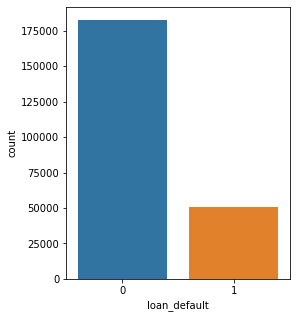

In [101]:
plt.figure(figsize=(4,5))
sns.countplot(df['loan_default'])

In [94]:
from imblearn.over_sampling import SMOTE
#Doing SMOTE to overcome the imbalance in the data

X = df_sampling
y = df['loan_default']

oversample = SMOTE()
X, y = oversample.fit_resample(X, y)
y.value_counts()

NameError: name 'df_sampling' is not defined

<AxesSubplot:xlabel='loan_default', ylabel='count'>

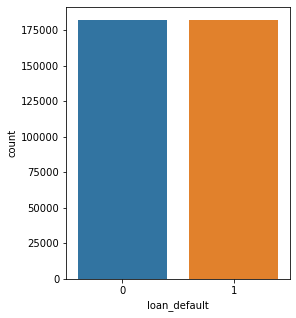

In [100]:
plt.figure(figsize=(4,5))
sns.countplot(y['loan_default'])

In [96]:
y.head()

,loan_default
0,0
1,1
2,0
3,1
4,1


In [508]:
X.shape

(364212, 29)

In [509]:
y.shape

(364212,)

In [510]:
X_scaled = X.copy()

In [4]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_auc_score, plot_confusion_matrix, roc_curve, recall_score

In [5]:
def plot_cm(y_test,y_pred):
    cm = confusion_matrix(y_test,y_pred)
    conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:No','Predicted:Yes'], 
                           index = ['Actual:No','Actual:Yes'])
    sns.heatmap(conf_matrix, annot = True, fmt = 'd', cbar = False, 
            linewidths = 0.1, annot_kws = {'size':25})

In [6]:
def plot_roc(y_test,y_pred):
    fpr, tpr, thresholds = roc_curve(y_test,y_pred)
    plt.plot(fpr, tpr)

    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])

# plot the straight line showing worst prediction for the model
    plt.plot([0, 1], [0, 1],'r--')

# add plot and axes labels
# set text size using 'fontsize'
    plt.title('ROC curve', fontsize = 15)
    plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
    plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)
    plt.text(x = 0.02, y = 0.9, s = ('AUC Score for full model:',round(roc_auc_score(y_test, y_pred),4)))


In [7]:
def print_cr(y_test,y_pred):
    print(classification_report(y_test,y_pred))
    print(recall_score(y_test,y_pred))

In [8]:

X= pd.read_csv('X 2.csv')
y= pd.read_csv('y 2.csv')
X_scaled= pd.read_csv('X_scaled 1.csv')

In [13]:
X.columns

Index(['asset_cost', 'ltv', 'PERFORM_CNS.SCORE', 'PRI.OVERDUE.ACCTS',
       'PRI.CURRENT.BALANCE', 'SEC.NO.OF.ACCTS', 'SEC.ACTIVE.ACCTS',
       'SEC.CURRENT.BALANCE', 'PRIMARY.INSTAL.AMT', 'SEC.INSTAL.AMT',
       'NEW.ACCTS.IN.LAST.SIX.MONTHS', 'DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS',
       'AVERAGE.ACCT.AGE', 'NO.OF_INQUIRIES', 'total_verification_wts',
       'Employment.Type_Self employed',
       'PERFORM_CNS.SCORE.DESCRIPTION_Low Risk',
       'PERFORM_CNS.SCORE.DESCRIPTION_Medium Risk',
       'PERFORM_CNS.SCORE.DESCRIPTION_Not Scored',
       'PERFORM_CNS.SCORE.DESCRIPTION_Very High Risk',
       'PERFORM_CNS.SCORE.DESCRIPTION_Very Low Risk',
       'State_ID_cat_High-Medium', 'State_ID_cat_Low', 'State_ID_cat_Medium',
       'State_ID_cat_Medium-Low', 'Age_30-40', 'Age_40-50', 'Age_50-60',
       'Age_60-70'],
      dtype='object')

In [14]:
y.columns

Index(['loan_default'], dtype='object')

## Base Model

### Logistic Regression

**Scaling Numeric Columns for Logistic Regression**

In [9]:
from scipy.stats import zscore

In [10]:
for feat in df_new_10.columns:
    X_scaled[feat] = zscore(X_scaled[feat])

NameError: name 'df_new_10' is not defined

In [12]:
X_scaled.head()

,asset_cost,ltv,PERFORM_CNS.SCORE,PRI.OVERDUE.ACCTS,PRI.CURRENT.BALANCE,SEC.NO.OF.ACCTS,SEC.ACTIVE.ACCTS,SEC.CURRENT.BALANCE,PRIMARY.INSTAL.AMT,SEC.INSTAL.AMT,NEW.ACCTS.IN.LAST.SIX.MONTHS,DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS,AVERAGE.ACCT.AGE,NO.OF_INQUIRIES,total_verification_wts,Employment.Type_Self employed,PERFORM_CNS.SCORE.DESCRIPTION_Low Risk,PERFORM_CNS.SCORE.DESCRIPTION_Medium Risk,PERFORM_CNS.SCORE.DESCRIPTION_Not Scored,PERFORM_CNS.SCORE.DESCRIPTION_Very High Risk,PERFORM_CNS.SCORE.DESCRIPTION_Very Low Risk,State_ID_cat_High-Medium,State_ID_cat_Low,State_ID_cat_Medium,State_ID_cat_Medium-Low,Age_30-40,Age_40-50,Age_50-60,Age_60-70
0,-0.93767,1.58306,-0.84547,-0.38427,-0.45999,-0.14550,-0.12083,-0.07521,-0.37015,-0.06022,-0.50903,-0.31401,-0.84295,-0.41351,-0.18181,0,0,0,1,0,0,1,0,0,0,1,0,0,0
1,-0.55805,-0.39958,1.02544,2.37402,0.04433,-0.14550,-0.12083,-0.07521,0.09776,-0.06022,-0.50903,3.14751,1.37261,-0.41351,-0.18181,1,0,1,0,0,0,1,0,0,0,1,0,0,0
2,-0.78051,1.59506,-0.84547,-0.38427,-0.45999,-0.14550,-0.12083,-0.07521,-0.37015,-0.06022,-0.50903,-0.31401,-0.84295,-0.41351,-0.18181,1,0,0,1,0,0,1,0,0,0,1,0,0,0
3,-0.52816,1.42488,0.10875,-0.38427,-0.45999,-0.14550,-0.12083,-0.07521,-0.31176,-0.06022,-0.50903,-0.31401,0.46372,2.00444,-0.18181,1,0,0,0,1,0,1,0,0,0,0,0,0,0
4,-0.83679,1.41177,-0.84547,-0.38427,-0.45999,-0.14550,-0.12083,-0.07521,-0.37015,-0.06022,-0.50903,-0.31401,-0.84295,2.00444,-0.18181,1,0,0,1,0,0,1,0,0,0,0,1,0,0


In [15]:
#X_scaled.to_csv('X_scaled.csv',index=False)
#X.to_csv('X.csv',index=False)
#y.to_csv('y.csv',index=False)

In [16]:
X_train_lr, X_test_lr, y_train_lr, y_test_lr = train_test_split(X_scaled,y,test_size=0.30,random_state=10)

In [17]:
lr = LogisticRegression()
lr.fit(X_train_lr,y_train_lr)

y_pred_lr = lr.predict(X_test_lr)

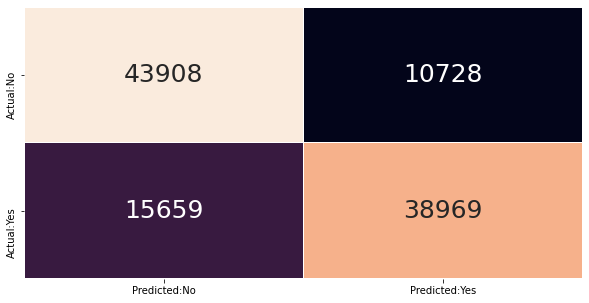

In [18]:
plot_cm(y_test_lr,y_pred_lr)

              precision    recall  f1-score   support

           0       0.74      0.80      0.77     54636
           1       0.78      0.71      0.75     54628

    accuracy                           0.76    109264
   macro avg       0.76      0.76      0.76    109264
weighted avg       0.76      0.76      0.76    109264

0.7133521271143004


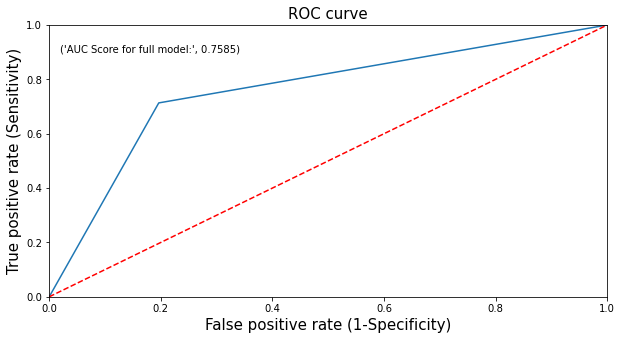

In [19]:
plot_roc(y_test_lr,y_pred_lr)
print_cr(y_test_lr,y_pred_lr)

In [20]:
## Train part
y_pred_lr_train = lr.predict(X_train_lr)
print_cr(y_train_lr,y_pred_lr_train)

              precision    recall  f1-score   support

           0       0.74      0.81      0.77    127470
           1       0.79      0.71      0.75    127478

    accuracy                           0.76    254948
   macro avg       0.76      0.76      0.76    254948
weighted avg       0.76      0.76      0.76    254948

0.7132995497262272


**Train test split for unscaled, sampled data**

In [21]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.30,random_state=10)

### Decision Tree

In [22]:
dt = DecisionTreeClassifier(random_state = 0)
dt.fit(X_train,y_train)

y_pred_dt= dt.predict(X_test)

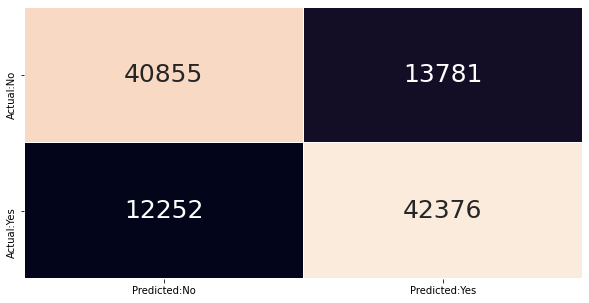

In [23]:
plot_cm(y_test,y_pred_dt)

              precision    recall  f1-score   support

           0       0.77      0.75      0.76     54636
           1       0.75      0.78      0.77     54628

    accuracy                           0.76    109264
   macro avg       0.76      0.76      0.76    109264
weighted avg       0.76      0.76      0.76    109264

0.775719411290913


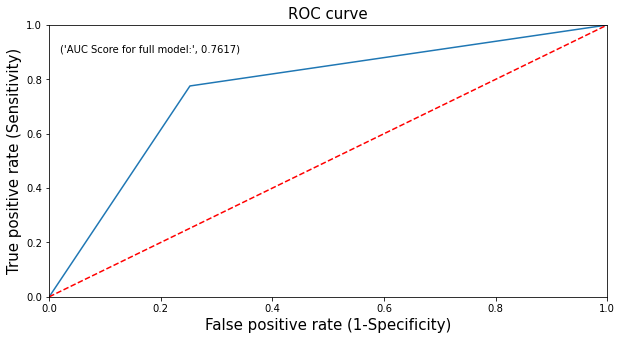

In [24]:
plot_roc(y_test,y_pred_dt)
print_cr(y_test,y_pred_dt)

In [25]:
## Train part
y_pred_dt_train = dt.predict(X_train)
print_cr(y_train,y_pred_dt_train)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    127470
           1       1.00      1.00      1.00    127478

    accuracy                           1.00    254948
   macro avg       1.00      1.00      1.00    254948
weighted avg       1.00      1.00      1.00    254948

0.9955992406532892


### Random Forest

In [26]:
rf = RandomForestClassifier(random_state = 0)
rf.fit(X_train,y_train)

y_pred_rf= rf.predict(X_test)

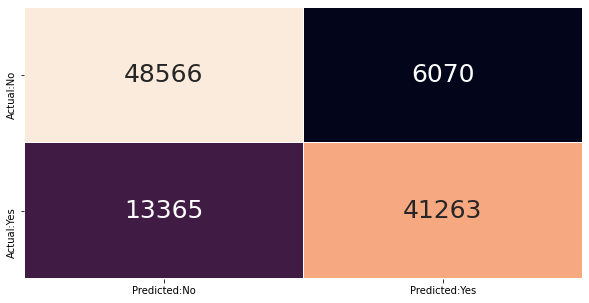

In [27]:
plot_cm(y_test,y_pred_rf)

              precision    recall  f1-score   support

           0       0.78      0.89      0.83     54636
           1       0.87      0.76      0.81     54628

    accuracy                           0.82    109264
   macro avg       0.83      0.82      0.82    109264
weighted avg       0.83      0.82      0.82    109264

0.755345244197115


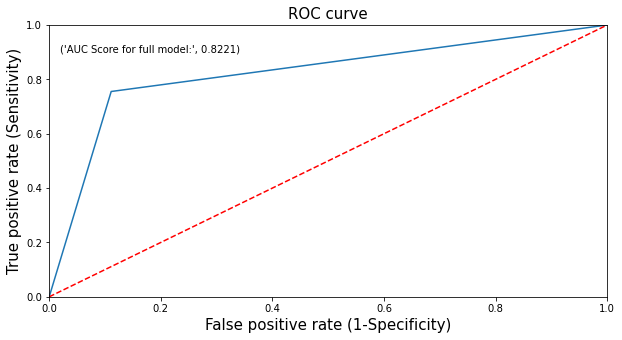

In [28]:
plot_roc(y_test,y_pred_rf)
print_cr(y_test,y_pred_rf)

In [29]:
## Train part
y_pred_rf_train = rf.predict(X_train)
print_cr(y_train,y_pred_rf_train)

              precision    recall  f1-score   support

           0       1.00      0.99      0.99    127470
           1       0.99      1.00      0.99    127478

    accuracy                           0.99    254948
   macro avg       0.99      0.99      0.99    254948
weighted avg       0.99      0.99      0.99    254948

0.9969955600181992


### Ada Boost

In [30]:
abc = AdaBoostClassifier(random_state = 0)
abc.fit(X_train,y_train)

y_pred_abc= abc.predict(X_test)

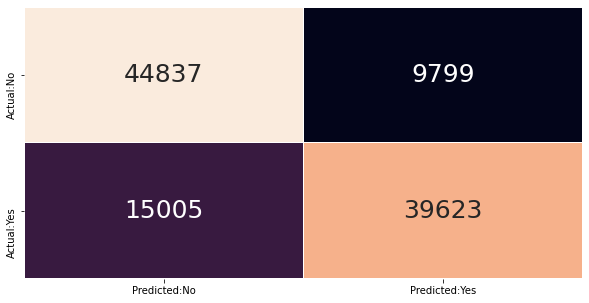

In [31]:
plot_cm(y_test,y_pred_abc)

              precision    recall  f1-score   support

           0       0.75      0.82      0.78     54636
           1       0.80      0.73      0.76     54628

    accuracy                           0.77    109264
   macro avg       0.78      0.77      0.77    109264
weighted avg       0.78      0.77      0.77    109264

0.725324009665373


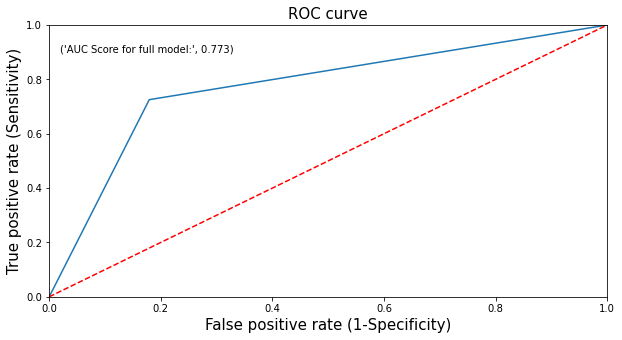

In [32]:
plot_roc(y_test,y_pred_abc)
print_cr(y_test,y_pred_abc)

In [33]:
## Train part
y_pred_abc_train = abc.predict(X_train)
print_cr(y_train,y_pred_abc_train)

              precision    recall  f1-score   support

           0       0.75      0.82      0.79    127470
           1       0.81      0.73      0.76    127478

    accuracy                           0.77    254948
   macro avg       0.78      0.77      0.77    254948
weighted avg       0.78      0.77      0.77    254948

0.7254035990523855


### Gradient Boosting

In [34]:
gbc = GradientBoostingClassifier(random_state = 0)
gbc.fit(X_train,y_train)

y_pred_gbc= gbc.predict(X_test)

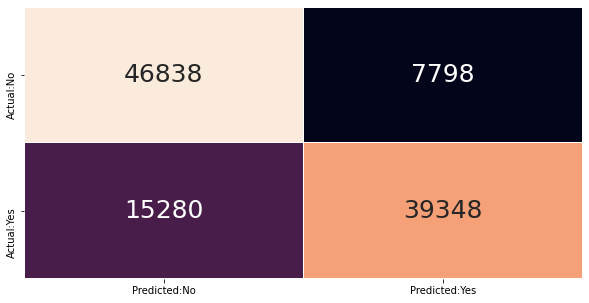

In [35]:
plot_cm(y_test,y_pred_gbc)

              precision    recall  f1-score   support

           0       0.75      0.86      0.80     54636
           1       0.83      0.72      0.77     54628

    accuracy                           0.79    109264
   macro avg       0.79      0.79      0.79    109264
weighted avg       0.79      0.79      0.79    109264

0.7202899611920627


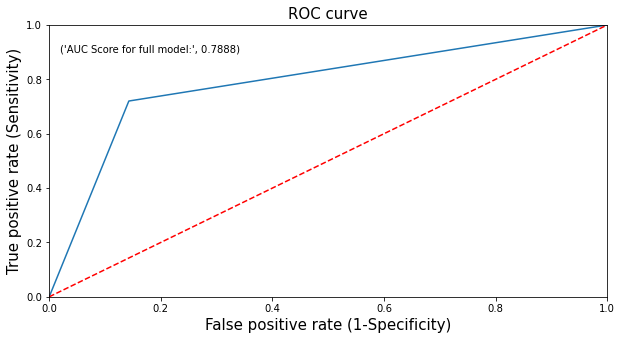

In [36]:
plot_roc(y_test,y_pred_gbc)
print_cr(y_test,y_pred_gbc)

In [37]:
## Train part
y_pred_gbc_train = gbc.predict(X_train)
print_cr(y_train,y_pred_gbc_train)

              precision    recall  f1-score   support

           0       0.76      0.86      0.80    127470
           1       0.84      0.72      0.78    127478

    accuracy                           0.79    254948
   macro avg       0.80      0.79      0.79    254948
weighted avg       0.80      0.79      0.79    254948

0.7211205070678862


### XG BOOST

In [39]:
import xgboost as xgb
from xgboost import XGBClassifier

In [43]:
#conda install -c anaconda py-xgboost 

In [44]:
xgb = XGBClassifier(random_state = 0)
xgb.fit(X_train,y_train)

y_pred_xgb= xgb.predict(X_test)

[21:08:06] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-6691-43e9a6c0910f/volume/xgboost-split_1619728204606/work/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


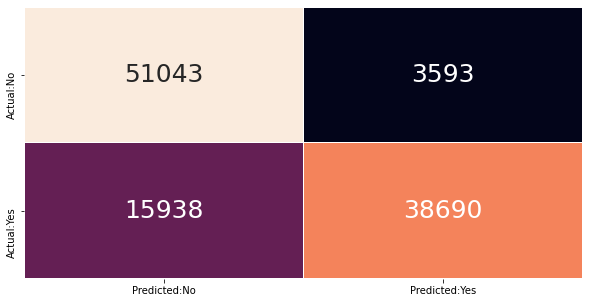

In [45]:
plot_cm(y_test,y_pred_xgb)

              precision    recall  f1-score   support

           0       0.76      0.93      0.84     54636
           1       0.92      0.71      0.80     54628

    accuracy                           0.82    109264
   macro avg       0.84      0.82      0.82    109264
weighted avg       0.84      0.82      0.82    109264

0.7082448561177418


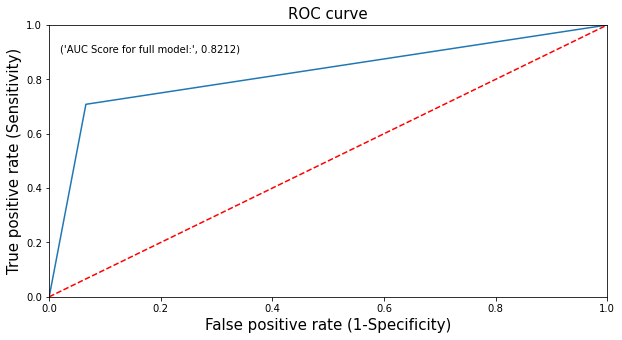

In [46]:
plot_roc(y_test,y_pred_xgb)
print_cr(y_test,y_pred_xgb)

In [47]:
## Train part
y_pred_xgb_train = xgb.predict(X_train)
print_cr(y_train,y_pred_xgb_train)

              precision    recall  f1-score   support

           0       0.77      0.94      0.85    127470
           1       0.92      0.71      0.81    127478

    accuracy                           0.83    254948
   macro avg       0.85      0.83      0.83    254948
weighted avg       0.85      0.83      0.83    254948

0.7143899339493873


### Naive Bayes

In [48]:
gnb = GaussianNB()
gnb.fit(X_train,y_train)

y_pred_gnb= gnb.predict(X_test)

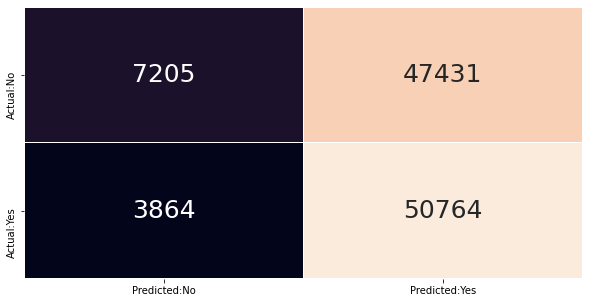

In [49]:
plot_cm(y_test,y_pred_gnb)

              precision    recall  f1-score   support

           0       0.65      0.13      0.22     54636
           1       0.52      0.93      0.66     54628

    accuracy                           0.53    109264
   macro avg       0.58      0.53      0.44    109264
weighted avg       0.58      0.53      0.44    109264

0.929267042542286


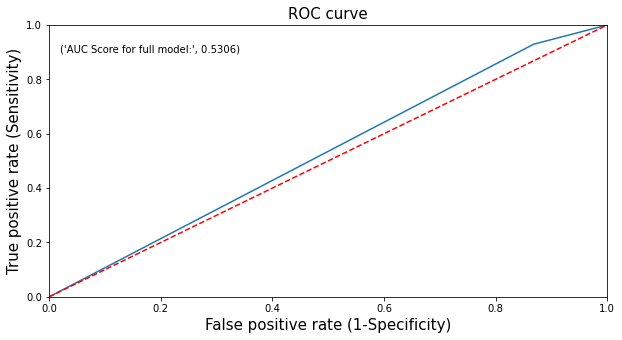

In [50]:
plot_roc(y_test,y_pred_gnb)
print_cr(y_test,y_pred_gnb)

In [51]:
#Train part
y_pred_gnb_train = gnb.predict(X_train)
print_cr(y_train,y_pred_gnb_train)

              precision    recall  f1-score   support

           0       0.65      0.13      0.22    127470
           1       0.52      0.93      0.66    127478

    accuracy                           0.53    254948
   macro avg       0.58      0.53      0.44    254948
weighted avg       0.58      0.53      0.44    254948

0.9298074961954219


## Ensemble

In [52]:
y_pred_test_df = pd.DataFrame({'Logistic Regression':y_pred_lr, 'Decision Tree':y_pred_dt, 'Random Forest':y_pred_rf,
                            'Ada Boost':y_pred_abc, 'XG boost':y_pred_xgb,'GB Boost':y_pred_gbc}) #,'Naive Bayes':y_pred_gnb

y_pred_test_df.head()

,Logistic Regression,Decision Tree,Random Forest,Ada Boost,XG boost,GB Boost
0,1,1,1,1,1,1
1,1,1,1,1,1,1
2,0,1,0,0,0,0
3,1,1,1,1,1,1
4,0,0,0,0,0,0


In [53]:
from scipy import stats
a = y_pred_test_df.values
m = stats.mode(a,axis=1)
print(m)

ModeResult(mode=array([[1],
       [1],
       [0],
       ...,
       [0],
       [0],
       [1]]), count=array([[6],
       [6],
       [5],
       ...,
       [6],
       [6],
       [6]]))


In [54]:
Voted_Result = pd.Series(m)
y_pred_test_df['Voted_Result'] = Voted_Result[0]

In [55]:
y_pred_test_df.head()

,Logistic Regression,Decision Tree,Random Forest,Ada Boost,XG boost,GB Boost,Voted_Result
0,1,1,1,1,1,1,1
1,1,1,1,1,1,1,1
2,0,1,0,0,0,0,0
3,1,1,1,1,1,1,1
4,0,0,0,0,0,0,0


              precision    recall  f1-score   support

           0       0.75      0.91      0.83     54636
           1       0.89      0.70      0.79     54628

    accuracy                           0.81    109264
   macro avg       0.82      0.81      0.81    109264
weighted avg       0.82      0.81      0.81    109264

0.7027714725049425


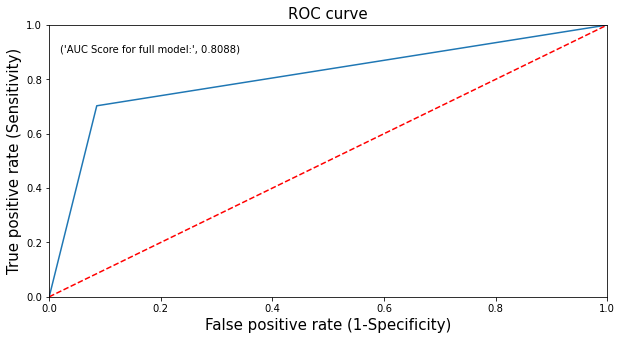

In [56]:
plot_roc(y_test,y_pred_test_df['Voted_Result'])
print_cr(y_test,y_pred_test_df['Voted_Result'])

In [57]:
y_pred_train_df = pd.DataFrame({'Logistic Regression':y_pred_lr_train, 'Decision Tree':y_pred_dt_train, 'Random Forest':y_pred_rf_train,
                            'Ada Boost':y_pred_abc_train, 'XG boost':y_pred_xgb_train,'GB Boost':y_pred_gbc_train})#'Naive Bayes':y_pred_gnb_train

y_pred_train_df.head()

,Logistic Regression,Decision Tree,Random Forest,Ada Boost,XG boost,GB Boost
0,1,1,1,1,1,1
1,0,0,0,0,0,0
2,0,0,0,0,0,0
3,1,0,0,0,0,0
4,0,0,0,0,0,0


In [58]:
b = y_pred_train_df.values
m = stats.mode(b,axis=1)

In [59]:
Voted_Result_train = pd.Series(m)
y_pred_train_df['Voted_Result'] = Voted_Result_train[0]

In [60]:
y_pred_train_df.head()

,Logistic Regression,Decision Tree,Random Forest,Ada Boost,XG boost,GB Boost,Voted_Result
0,1,1,1,1,1,1,1
1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0
3,1,0,0,0,0,0,0
4,0,0,0,0,0,0,0


              precision    recall  f1-score   support

           0       0.78      0.95      0.86    127470
           1       0.94      0.74      0.82    127478

    accuracy                           0.84    254948
   macro avg       0.86      0.84      0.84    254948
weighted avg       0.86      0.84      0.84    254948

0.7358603053075825


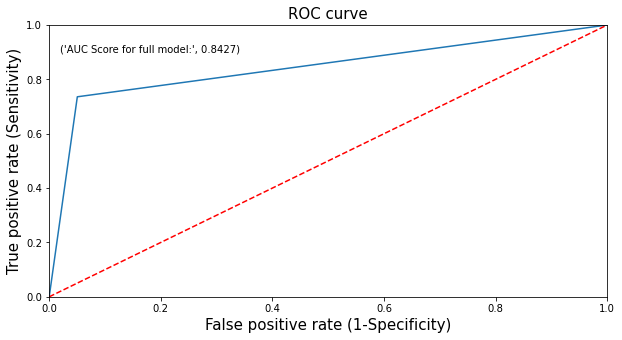

In [61]:
plot_roc(y_train,y_pred_train_df['Voted_Result'])
print_cr(y_train,y_pred_train_df['Voted_Result'])

## Tuning


lr= 0.1
[21:11:26] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-6691-43e9a6c0910f/volume/xgboost-split_1619728204606/work/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
              precision    recall  f1-score   support

           0       0.76      0.93      0.84     54636
           1       0.91      0.70      0.79     54628

    accuracy                           0.82    109264
   macro avg       0.84      0.82      0.82    109264
weighted avg       0.84      0.82      0.82    109264

0.7021490810573332
Train

              precision    recall  f1-score   support

           0       0.76      0.94      0.84    127470
           1       0.92      0.70      0.80    127478

    accuracy                           0.82    254948
   macro avg       0.84      0.82      0.82    254948
weight

              precision    recall  f1-score   support

           0       0.78      0.93      0.85    127470
           1       0.92      0.74      0.82    127478

    accuracy                           0.84    254948
   macro avg       0.85      0.84      0.84    254948
weighted avg       0.85      0.84      0.84    254948

0.7444421782582092
lr= 0.9
[21:12:58] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-6691-43e9a6c0910f/volume/xgboost-split_1619728204606/work/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
              precision    recall  f1-score   support

           0       0.77      0.91      0.83     54636
           1       0.89      0.72      0.80     54628

    accuracy                           0.82    109264
   macro avg       0.83      0.82      0.81    109264
weighted avg 

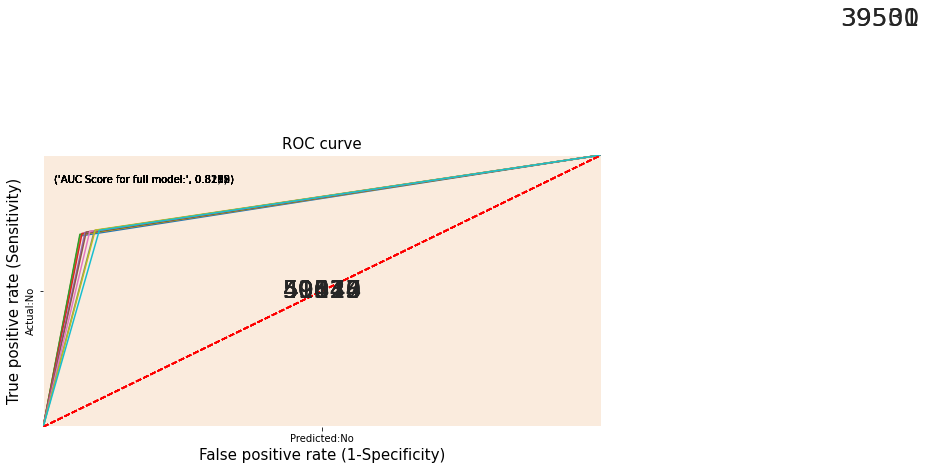

In [62]:
for i in [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]:
    print('lr=',i)
    xgb = XGBClassifier(learning_rate =i,random_state=0)
    xgb.fit(X_train,y_train)
    y_pred_xgb= xgb.predict(X_test)
    plot_cm(y_test,y_pred_xgb)
    plot_roc(y_test,y_pred_xgb)
    print_cr(y_test,y_pred_xgb)
    print('Train\n')
    y_pred_xgb_train = xgb.predict(X_train)
    print_cr(y_train,y_pred_xgb_train)

## Final Model

In [63]:
xgb = XGBClassifier(learning_rate=0.6,random_state = 0)
xgb.fit(X_train,y_train)

y_pred_xgb= xgb.predict(X_test)

[21:17:49] WARNING: /opt/concourse/worker/volumes/live/7a2b9f41-3287-451b-6691-43e9a6c0910f/volume/xgboost-split_1619728204606/work/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


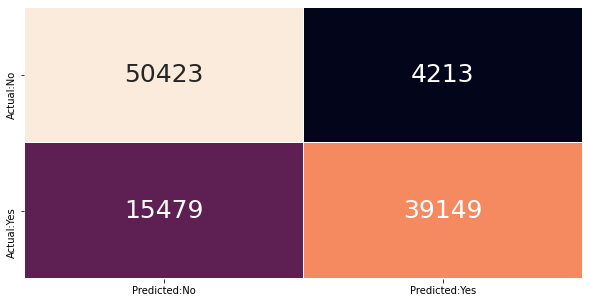

In [64]:
plot_cm(y_test,y_pred_xgb)

              precision    recall  f1-score   support

           0       0.77      0.92      0.84     54636
           1       0.90      0.72      0.80     54628

    accuracy                           0.82    109264
   macro avg       0.83      0.82      0.82    109264
weighted avg       0.83      0.82      0.82    109264

0.7166471406604672


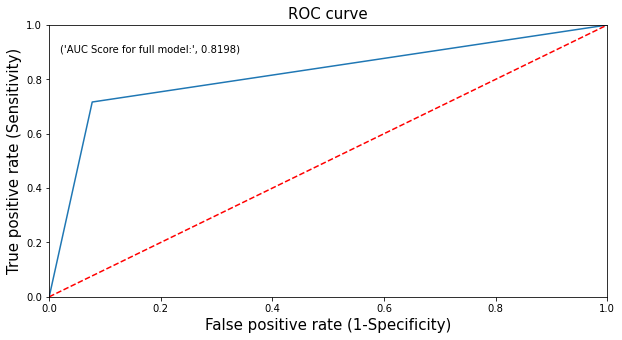

In [65]:
plot_roc(y_test,y_pred_xgb)
print_cr(y_test,y_pred_xgb)

In [66]:
## Train part
y_pred_xgb_train = xgb.predict(X_train)
print_cr(y_train,y_pred_xgb_train)

              precision    recall  f1-score   support

           0       0.78      0.94      0.85    127470
           1       0.92      0.73      0.82    127478

    accuracy                           0.83    254948
   macro avg       0.85      0.83      0.83    254948
weighted avg       0.85      0.83      0.83    254948

0.7316870361944806


In [110]:
df_imp = pd.DataFrame({'feature':X.columns,'Value':xgb.feature_importances_})
df_imp = df_imp.sort_values(by='Value',ascending=False)
#df_imp.set_index('feature',inplace=True)
df_imp

,feature,Value
20,PERFORM_CNS.SCORE.DESCRIPTION_Very Low Risk,0.17933
24,State_ID_cat_Medium-Low,0.09106
27,Age_50-60,0.07629
18,PERFORM_CNS.SCORE.DESCRIPTION_Not Scored,0.07349
26,Age_40-50,0.06987
13,NO.OF_INQUIRIES,0.06472
21,State_ID_cat_High-Medium,0.05304
22,State_ID_cat_Low,0.05076
23,State_ID_cat_Medium,0.04965
14,total_verification_wts,0.04897


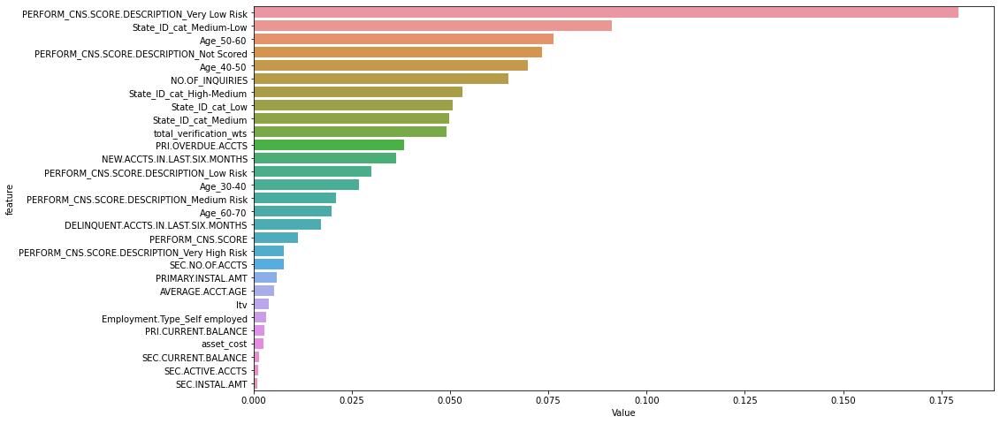

In [87]:
plt.figure(figsize=(15,8))
sns.barplot('Value','feature',data=df_imp)
plt.show()

In [92]:
ct = pd.crosstab(X_test['Age_50-60'],y_pred_xgb)
ct

col_0,0,1
Age_50-60,,
0,60553,43001
1,5349,361


In [95]:
target= [  'default' if i == 1 else 'not default' for i in y_pred_xgb ]
target

['default',
 'default',
 'not default',
 'default',
 'not default',
 'default',
 'not default',
 'default',
 'default',
 'not default',
 'default',
 'default',
 'not default',
 'not default',
 'not default',
 'not default',
 'default',
 'default',
 'not default',
 'not default',
 'not default',
 'default',
 'not default',
 'not default',
 'not default',
 'default',
 'not default',
 'default',
 'not default',
 'not default',
 'not default',
 'not default',
 'default',
 'default',
 'default',
 'default',
 'not default',
 'not default',
 'default',
 'not default',
 'default',
 'not default',
 'not default',
 'default',
 'default',
 'not default',
 'default',
 'not default',
 'not default',
 'not default',
 'default',
 'default',
 'not default',
 'not default',
 'default',
 'not default',
 'not default',
 'not default',
 'default',
 'not default',
 'not default',
 'default',
 'default',
 'not default',
 'not default',
 'not default',
 'default',
 'not default',
 'default',
 'default',
 'no

In [98]:
target= pd.Series(target,index=X_test.index,name='loan_default')

In [99]:
target

309286        default
317759        default
64941     not default
331281        default
91884     not default
347858        default
82701     not default
316246        default
19174         default
167421    not default
301987        default
318455        default
120320    not default
29427     not default
185810    not default
158138    not default
272394        default
320727        default
200801    not default
58414     not default
165769    not default
357203        default
204078    not default
71194     not default
126684    not default
279925        default
31892     not default
331240        default
131278    not default
92296     not default
43677     not default
134005    not default
286580        default
330049        default
241475        default
288690        default
210084    not default
164752    not default
284727        default
110231    not default
331615        default
59162     not default
47116     not default
354051        default
94501         default
33561     

In [100]:
Final_df = pd.concat([X_test,target],axis=1)

In [101]:
Final_df.head()

,asset_cost,ltv,PERFORM_CNS.SCORE,PRI.OVERDUE.ACCTS,PRI.CURRENT.BALANCE,SEC.NO.OF.ACCTS,SEC.ACTIVE.ACCTS,SEC.CURRENT.BALANCE,PRIMARY.INSTAL.AMT,SEC.INSTAL.AMT,NEW.ACCTS.IN.LAST.SIX.MONTHS,DELINQUENT.ACCTS.IN.LAST.SIX.MONTHS,AVERAGE.ACCT.AGE,NO.OF_INQUIRIES,total_verification_wts,Employment.Type_Self employed,PERFORM_CNS.SCORE.DESCRIPTION_Low Risk,PERFORM_CNS.SCORE.DESCRIPTION_Medium Risk,PERFORM_CNS.SCORE.DESCRIPTION_Not Scored,PERFORM_CNS.SCORE.DESCRIPTION_Very High Risk,PERFORM_CNS.SCORE.DESCRIPTION_Very Low Risk,State_ID_cat_High-Medium,State_ID_cat_Low,State_ID_cat_Medium,State_ID_cat_Medium-Low,Age_30-40,Age_40-50,Age_50-60,Age_60-70,loan_default
309286,64041,512403.88266,0,0.00000,0.00000,0.00000,0.00000,0.00000,9.95802,0.00000,0.00000,0.00000,0.03488,0.00000,0.00001,0,0,0,1,0,0,0,0,0,0,0,0,0,0,default
317759,42278,428271.99123,156,0.40028,159.39884,0.00000,0.00000,0.00000,48.85592,0.00000,0.40028,0.56609,1.20085,0.00000,0.00001,0,0,0,0,0,0,0,0,0,0,0,0,0,0,default
64941,70088,277538.68882,0,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00001,1,0,0,1,0,0,1,0,0,0,0,0,0,0,not default
331281,61116,439111.92258,395,0.00000,52.19363,0.00000,0.00000,0.00000,0.00000,0.00000,0.56087,0.00000,2.02223,0.00000,0.00001,1,0,0,0,0,0,0,0,0,0,0,0,0,0,default
91884,70541,47284.58831,641,1.00000,357.19462,1.00000,1.00000,262.55666,183.38484,0.00000,0.00000,0.00000,4.69042,0.00000,0.00001,0,1,0,0,0,0,0,1,0,0,1,0,0,0,not default


In [109]:
for col in df_imp['feature'].head():
    ct = pd.crosstab(Final_df[col],Final_df['loan_default'])
    print(ct)
    print('\n')

loan_default                                 default  not default
PERFORM_CNS.SCORE.DESCRIPTION_Very Low Risk                      
0                                              41377        50926
1                                               1985        14976


loan_default             default  not default
State_ID_cat_Medium-Low                      
0                          42078        57847
1                           1284         8055


loan_default  default  not default
Age_50-60                         
0               43001        60553
1                 361         5349


loan_default                              default  not default
PERFORM_CNS.SCORE.DESCRIPTION_Not Scored                      
0                                           22620        29602
1                                           20742        36300


loan_default  default  not default
Age_40-50                         
0               41645        52213
1                1717        13689




People with very low risk in cns score have low chances of loan defaulting


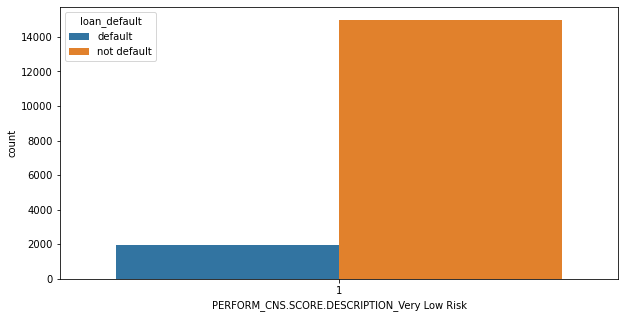

In [121]:
sns.countplot(Final_df[Final_df['PERFORM_CNS.SCORE.DESCRIPTION_Very Low Risk']==1]['PERFORM_CNS.SCORE.DESCRIPTION_Very Low Risk'],hue=Final_df['loan_default'])
print('People with very low risk in cns score have low chances of loan defaulting')

<AxesSubplot:xlabel='State_ID_cat_Medium-Low', ylabel='count'>

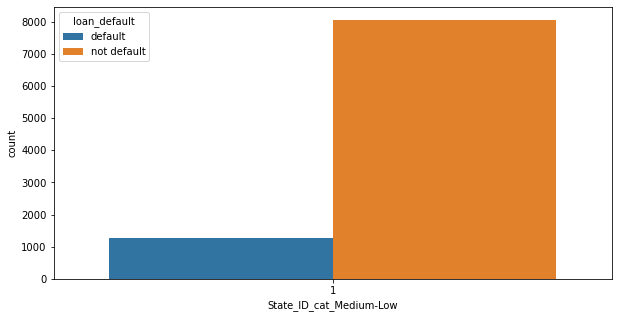

In [120]:
sns.countplot(Final_df[Final_df['State_ID_cat_Medium-Low']==1]['State_ID_cat_Medium-Low'],hue=Final_df['loan_default'])


In [ ]:
#People who belong to med-low state ID category i.e, states with state ID as 1,14 and 5 have low chances of loan defaulting

<AxesSubplot:xlabel='Age_50-60', ylabel='count'>

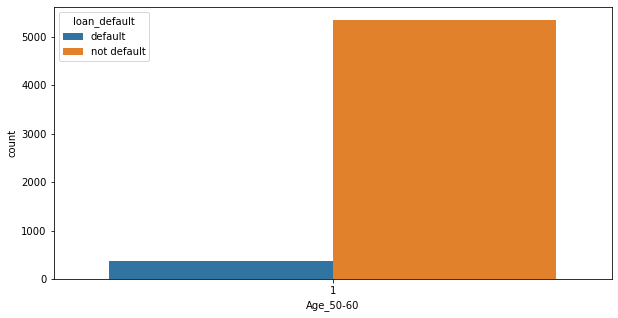

In [122]:
sns.countplot(Final_df[Final_df['Age_50-60']==1]['Age_50-60'],hue=Final_df['loan_default'])

In [ ]:
#People belonging to 50-60 years category have low chances of loan defaulting

<AxesSubplot:xlabel='PERFORM_CNS.SCORE.DESCRIPTION_Not Scored', ylabel='count'>

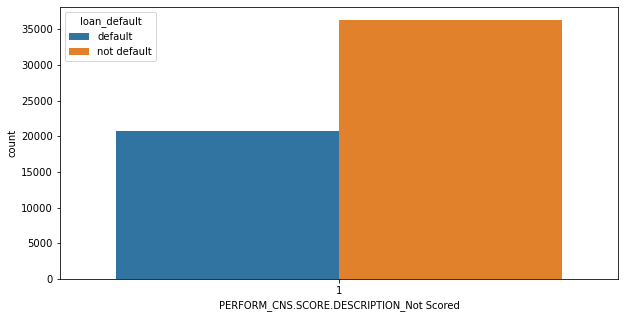

In [123]:
sns.countplot(Final_df[Final_df['PERFORM_CNS.SCORE.DESCRIPTION_Not Scored']==1]['PERFORM_CNS.SCORE.DESCRIPTION_Not Scored'],hue=Final_df['loan_default'])

In [ ]:
#People with no cns score have low chances of loan defaulting

<AxesSubplot:xlabel='Age_40-50', ylabel='count'>

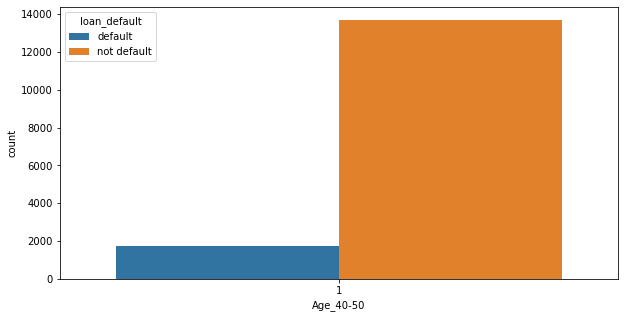

In [125]:
sns.countplot(Final_df[Final_df['Age_40-50']==1]['Age_40-50'],hue=Final_df['loan_default'])

In [ ]:
#People belonging to 40-50 years category have low chances of loan defaulting

<AxesSubplot:xlabel='Age_30-40', ylabel='count'>

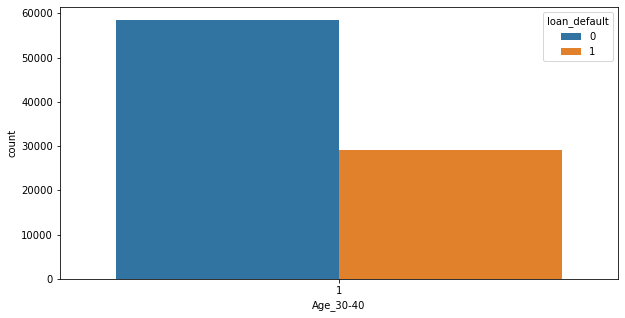

In [35]:
sns.countplot(X[X['Age_30-40']==1]['Age_30-40'],hue=y['loan_default'])

In [9]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 364212 entries, 0 to 364211
Data columns (total 29 columns):
 #   Column                                        Non-Null Count   Dtype  
---  ------                                        --------------   -----  
 0   asset_cost                                    364212 non-null  int64  
 1   ltv                                           364212 non-null  float64
 2   PERFORM_CNS.SCORE                             364212 non-null  int64  
 3   PRI.OVERDUE.ACCTS                             364212 non-null  float64
 4   PRI.CURRENT.BALANCE                           364212 non-null  float64
 5   SEC.NO.OF.ACCTS                               364212 non-null  float64
 6   SEC.ACTIVE.ACCTS                              364212 non-null  float64
 7   SEC.CURRENT.BALANCE                           364212 non-null  float64
 8   PRIMARY.INSTAL.AMT                            364212 non-null  float64
 9   SEC.INSTAL.AMT                                36

<AxesSubplot:xlabel='PERFORM_CNS.SCORE', ylabel='asset_cost'>

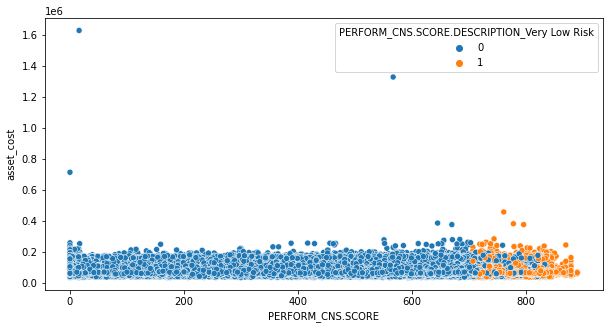

In [19]:
sns.scatterplot(X['PERFORM_CNS.SCORE'],X['asset_cost'],hue=X['PERFORM_CNS.SCORE.DESCRIPTION_Very Low Risk'])

<AxesSubplot:xlabel='asset_cost', ylabel='PERFORM_CNS.SCORE'>

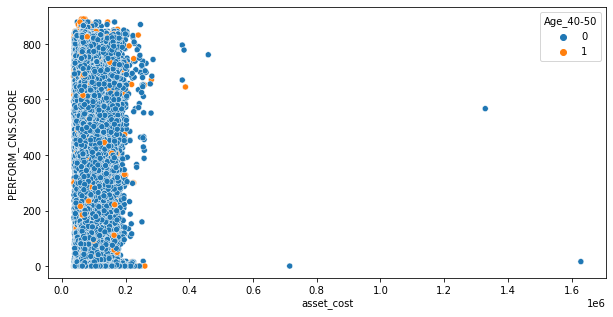

In [17]:
sns.scatterplot(X['asset_cost'],X['PERFORM_CNS.SCORE'],hue=X['Age_40-50'])

In [22]:
X['PERFORM_CNS.SCORE.DESCRIPTION_Not Scored'].value_counts()/len(X)*100

1   52.43183
0   47.56817
Name: PERFORM_CNS.SCORE.DESCRIPTION_Not Scored, dtype: float64

In [33]:
import scipy.stats as stats
stats.norm.isf(0.1) # right to left, after mean to calculate z using p
stats.norm.ppf(0.1) #left to rught, before mean, after mean to calculate z using p
stats.norm.cdf(-1.2815515655446004) #left to right, to calculate p using z

1.2815515655446004